# Find barcode

## Imports

C:\Users\zgstv\OneDrive\Изображения\vend_machines2\IMG_20211029_163506.jpg


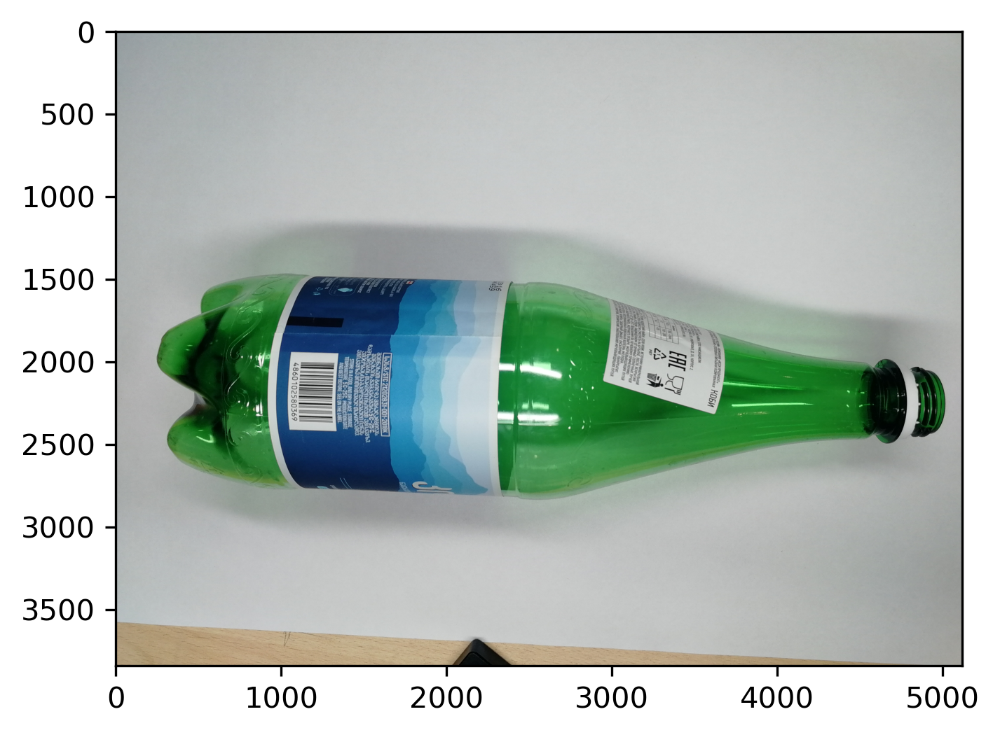

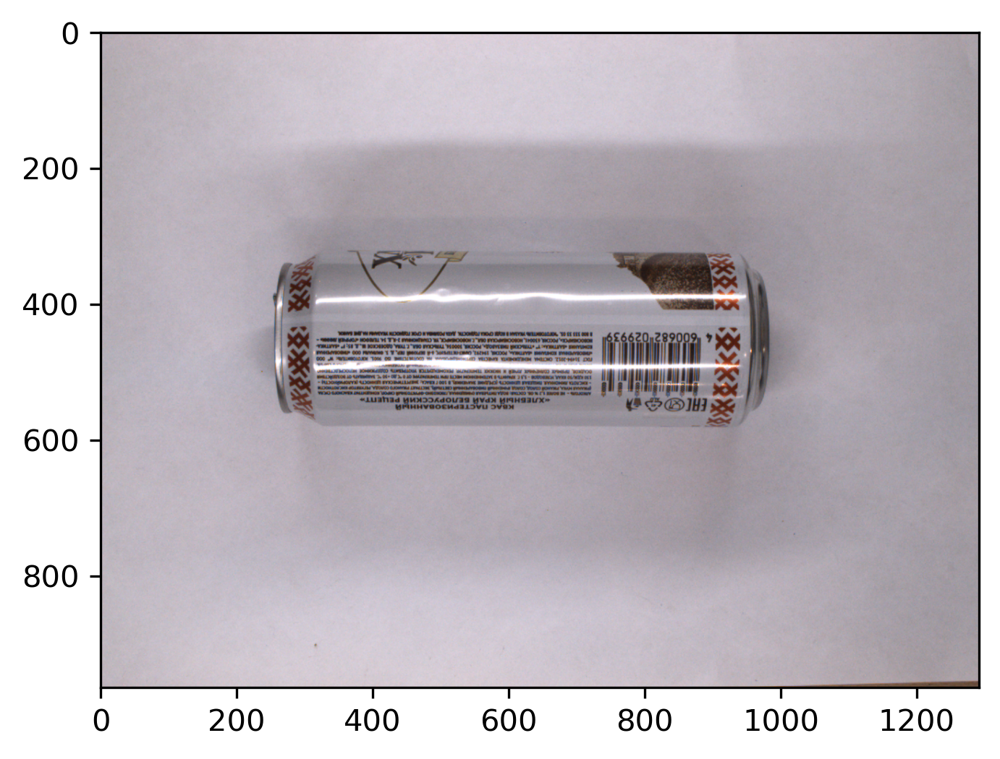

In [1]:
# close("all")
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import time
import os

import cv2 as cv
import matplotlib as plt
import numpy as np

# from matplotlib.pyplot import imshow
from matplotlib.pyplot import imread,figure,close,imsave,show
def imshow(img,name = None,cmap=None,dpi = 300):
    figure(dpi = dpi)
    plt.pyplot.imshow(img,cmap=cmap)
    if name:
        plt.pyplot.title(name)

def benchmark(func):
    def wrapper(*args,**kwargs):
        start = time.time()
        res = func(*args,**kwargs)
        end = time.time()
        print('[*] Время выполнения: {} секунд.'.format(end-start))
        return res
    return wrapper

test_imgs_folder_hq = "C:\\Users\\zgstv\\OneDrive\\Изображения\\vend_machines2"
test_imgs_folder_lq = "C:\\Users\\zgstv\\OneDrive\\Изображения\\vend_machines"
test_img_filename_green_hq = "IMG_20211029_163506.jpg"
test_img_filename_white_lq = "Aluminum can\\2021-10-20_13_32_41_568.png"
test_img_path_green_hq = os.path.join(test_imgs_folder_hq, test_img_filename_green_hq)
test_img_path_white_lq = os.path.join(test_imgs_folder_lq, test_img_filename_white_lq)

print(test_img_path_green_hq)
green_hq = imread(test_img_path_green_hq)
imshow(green_hq)
white_lq = imread(test_img_path_white_lq)
imshow(white_lq)

## Sobel filtering

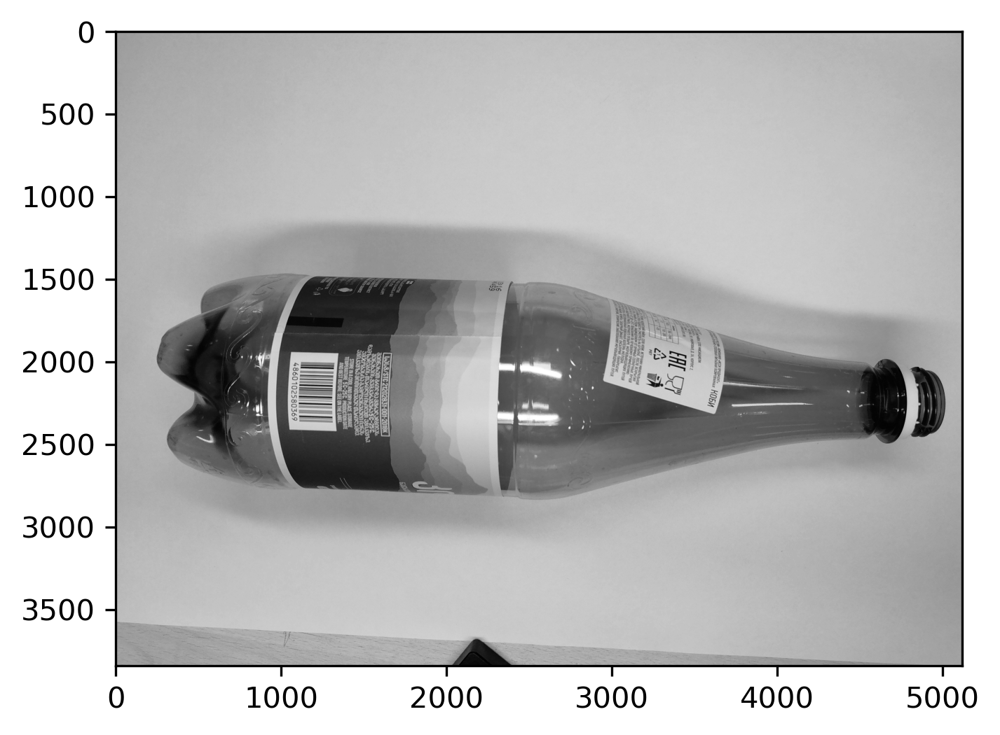

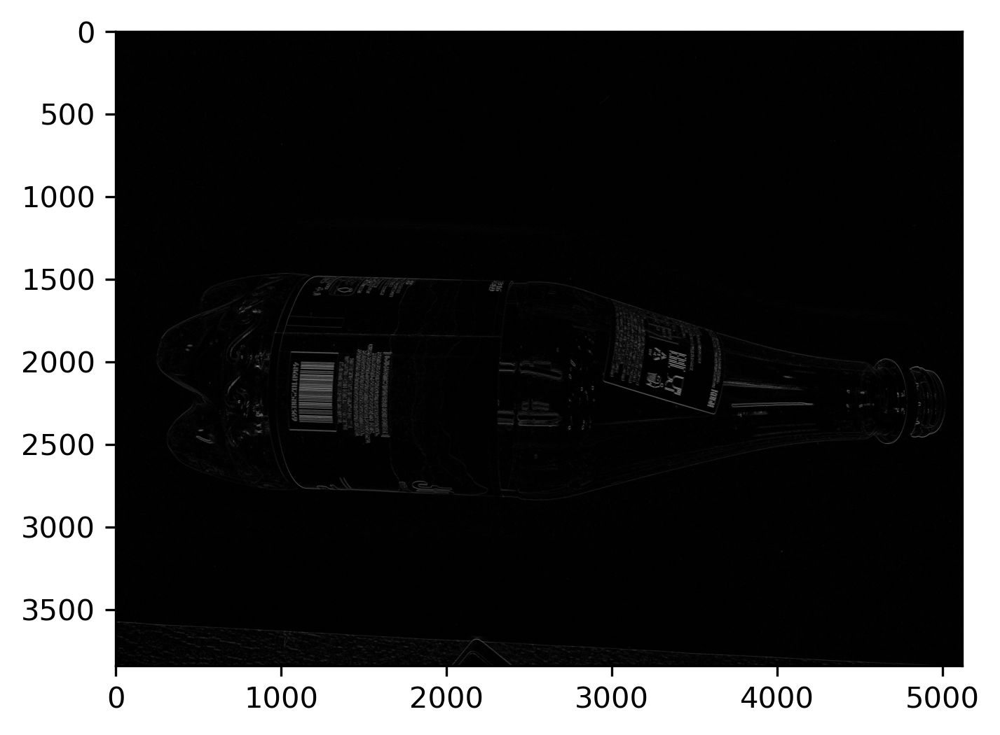

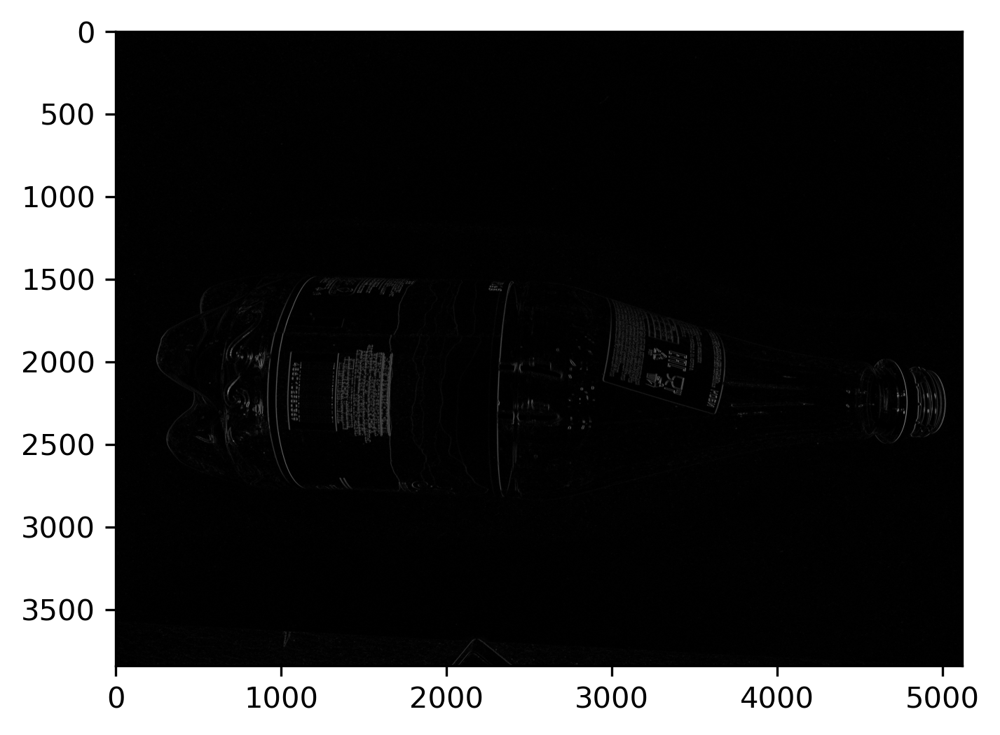

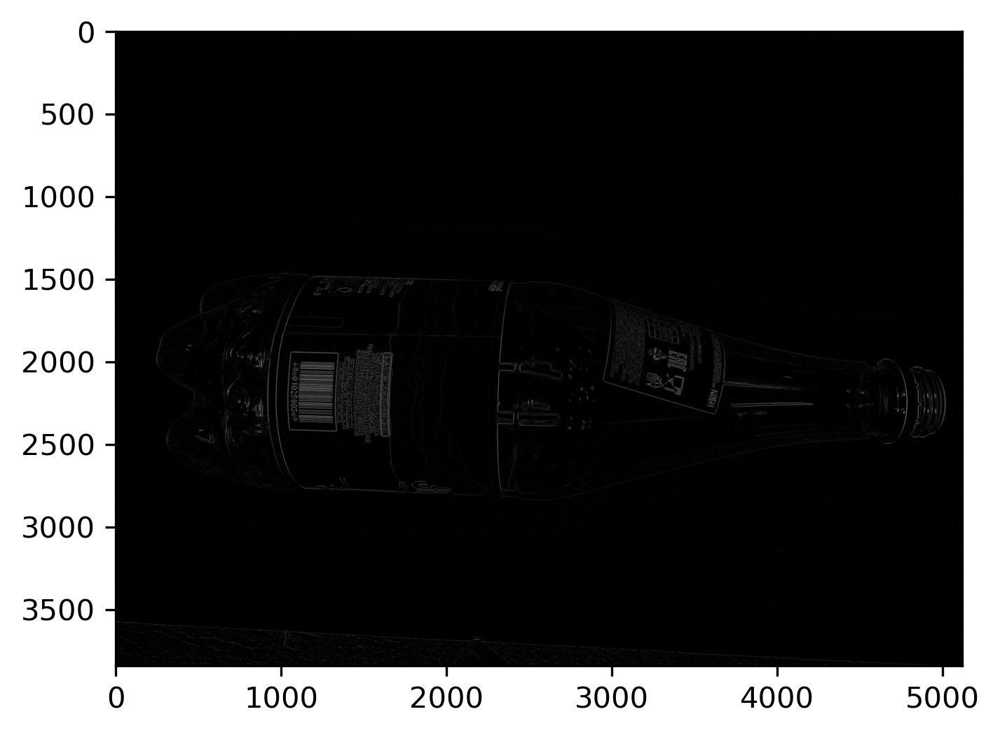

In [3]:
img = green_hq
gray = cv.cvtColor(img,cv.COLOR_RGB2GRAY);
imshow(gray,cmap="gray")
imsave('gray_negative.jpg', ~gray,cmap='gray')
# ret, binary = cv.threshold(gray,200,0,cv.THRESH_TOZERO_INV)
# figure(); imshow(binary,cmap="gray")
# ret, binary = cv.threshold(binary,55,255,cv.THRESH_BINARY_INV)
# figure(); imshow(binary,cmap="gray")


sobely = cv.Sobel(gray,cv.CV_64F,0,1,ksize=5)
sobely= np.absolute(sobely)
imshow(sobely,cmap="gray")
sobelx = cv.Sobel(gray,cv.CV_64F,1,0,ksize=5)
sobelx = np.absolute(sobelx)
imshow(sobelx,cmap="gray")


sub = cv.subtract(sobelx,sobely,dtype = cv.CV_64F)
sub = np.absolute(sub)
imshow(sub,cmap="gray")


## Pyzbar find and read barcode
**do not work for bottles images** 

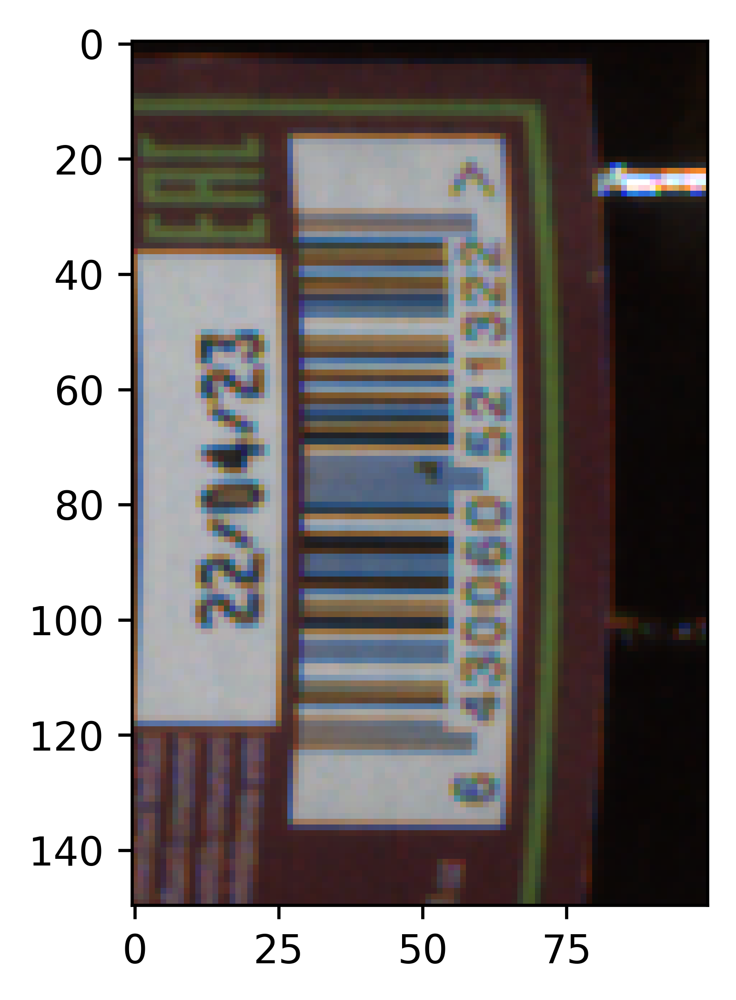

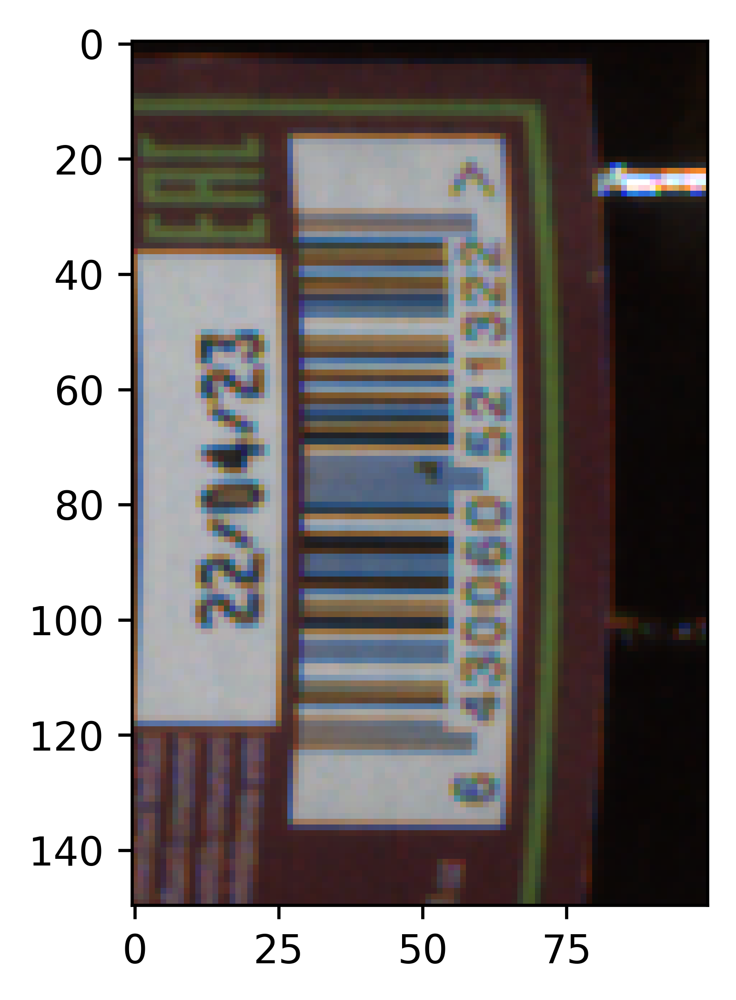

In [30]:
from __future__ import print_function
import pyzbar.pyzbar as pyzbar
import numpy as np
import cv2

def decode(im) :
    # Find barcodes and QR codes
    decodedObjects = pyzbar.decode(im)

    # Print results
    for obj in decodedObjects:
        print('Type : ', obj.type)
        print('Data : ', obj.data,'\n')

    return decodedObjects

# Display barcode and QR code location
def display(im, decodedObjects):
    
    # Loop over all decoded objects
    for decodedObject in decodedObjects:
        points = decodedObject.polygon

        # If the points do not form a quad, find convex hull
        if len(points) > 4 :
            hull = cv2.convexHull(np.array([point for point in points], dtype=np.float32))
            hull = list(map(tuple, np.squeeze(hull)))
        else :
            hull = points;

        # Number of points in the convex hull
        n = len(hull)

        # Draw the convext hull
        for j in range(0,n):
            cv2.line(im, hull[j], hull[ (j+1) % n], (255,0,0), 3)

    # Display results
    imshow(im);
#     cv2.waitKey(0);



  # Read image
# im = cv2.imread('zbar-test.jpg')
# im = test_img[1500:3000,500:2000]
im = barcodes[3]
imshow(im)

decodedObjects = decode(im)
display(im, decodedObjects)

## HOG sample in skimage

In [2]:
import matplotlib as plt

from skimage.feature import hog
from skimage import data, exposure


# image = data.astronaut()
image = green_hq

In [8]:
hogs = {}

hogs['8or 16x16p 1x1c']=hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True,multichannel = True)
hogs['16or 16x16p 1x1c'] = hog(image, orientations=16, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True,multichannel = True)
hogs['8or 8x8p 3x3c']= hog(image, orientations=8, pixels_per_cell=(8, 8),
                    cells_per_block=(3, 3), visualize=True,multichannel = True)
hogs['8or 32x32p 1x1c'] = hog(image, orientations=8, pixels_per_cell=(32, 32),
                    cells_per_block=(1, 1), visualize=True,multichannel = True)
hogs['8or 16x16p 3x3c'] = hog(image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(3, 3), visualize=True,multichannel = True)


In [5]:
# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4), sharex=True, sharey=True)

# ax1.axis('off')
# ax1.imshow(image, cmap=plt.cm.gray)
# ax1.set_title('Input image')

# # Rescale histogram for better display
# hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

# ax2.axis('off')
# ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
# ax2.set_title('Histogram of Oriented Gradients')
# plt.show()

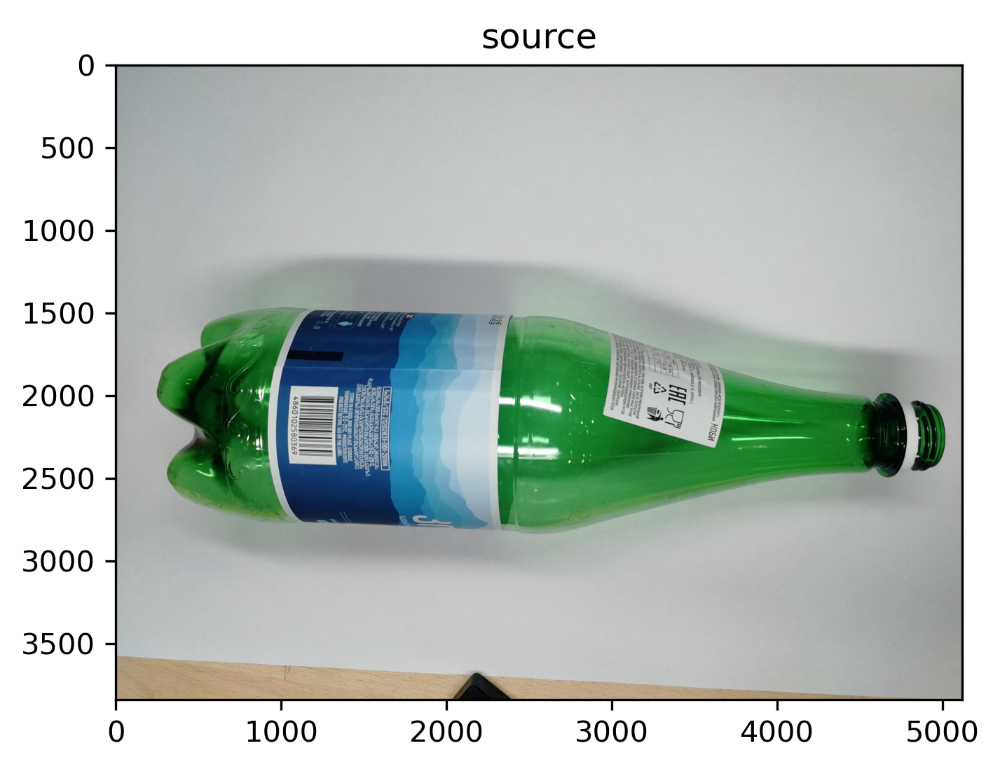

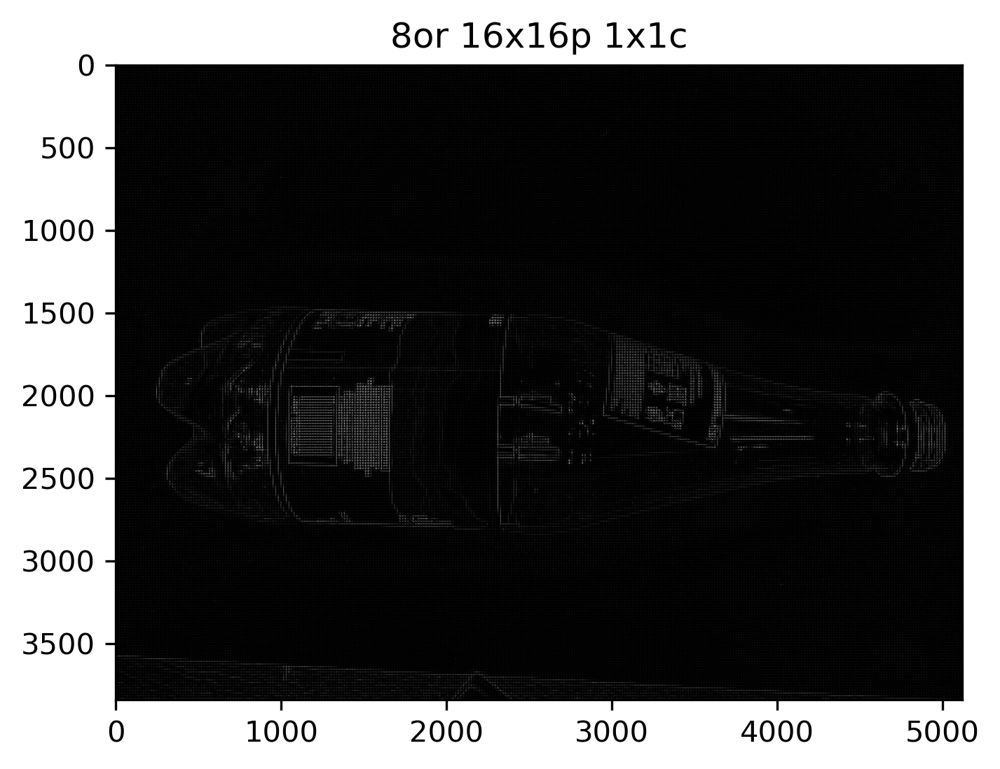

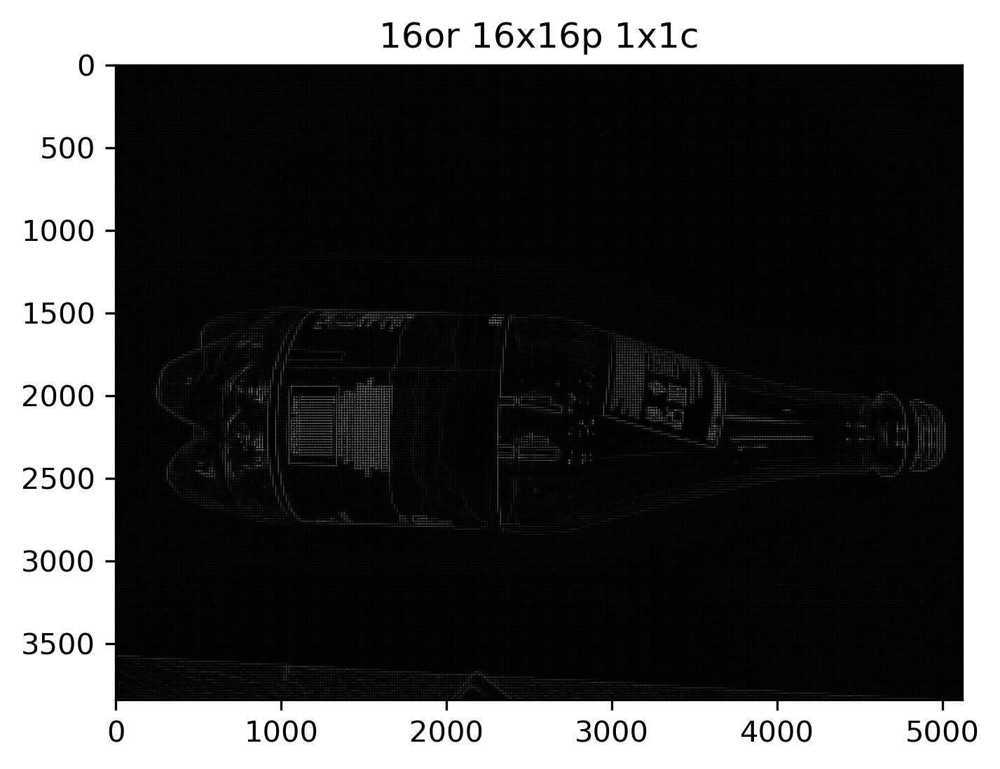

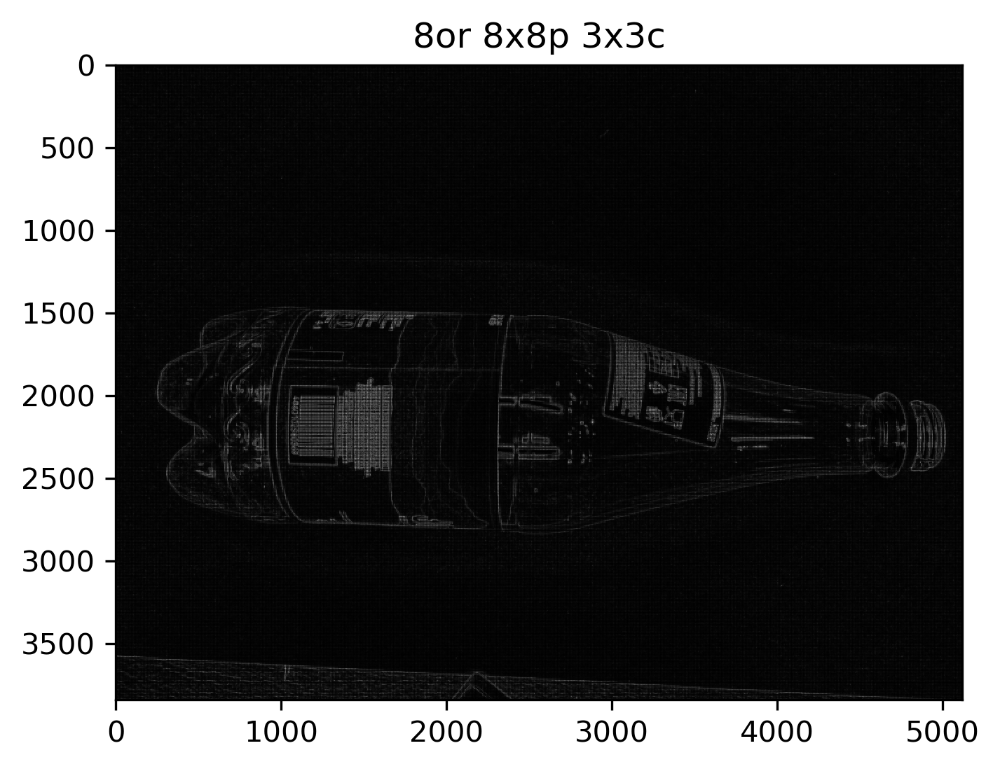

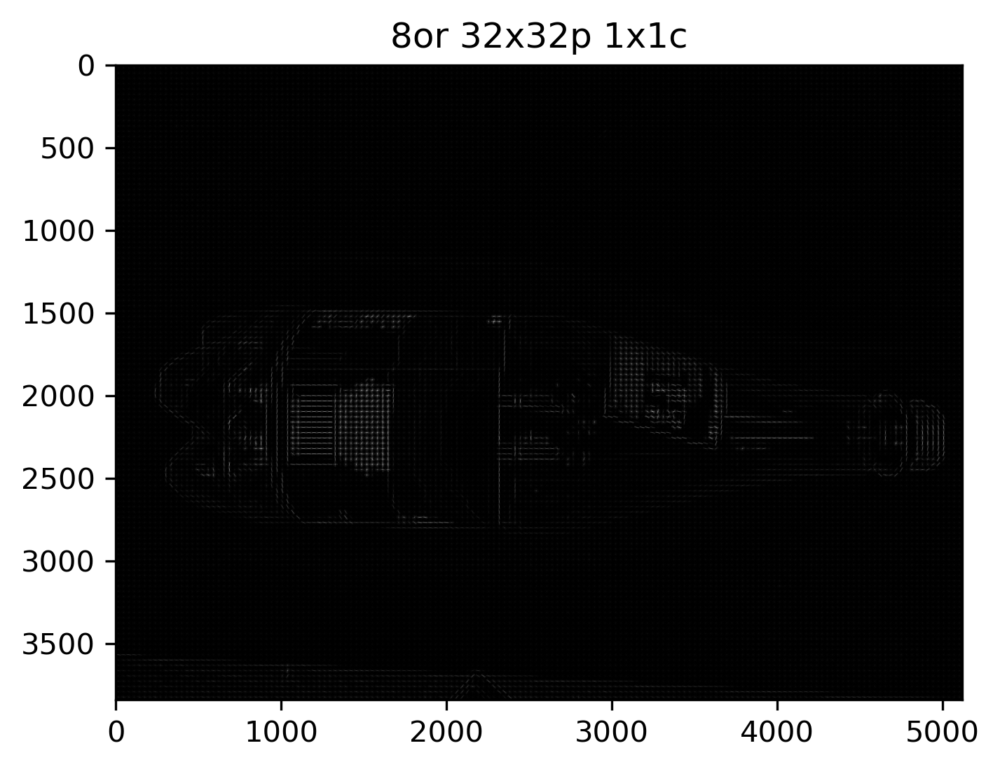

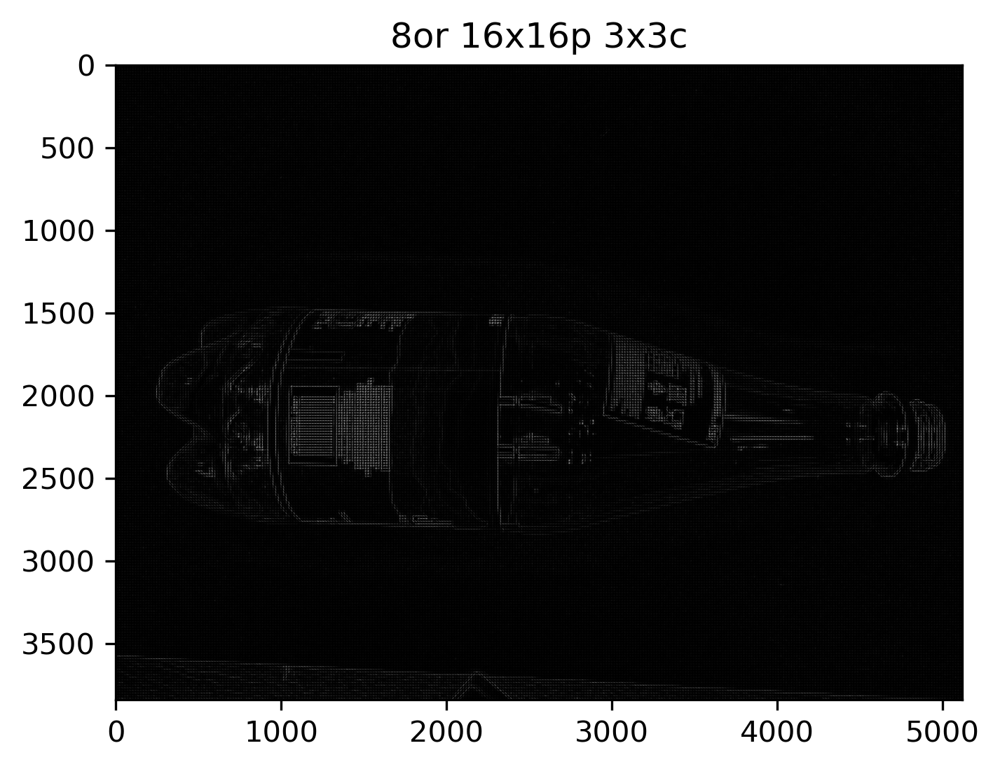

In [12]:
imshow(image,name = 'source', cmap=plt.cm.gray)

# Rescale histogram for better display
hogs_rescaled = {key: exposure.rescale_intensity(value[1], in_range=(0, 10)) for key, value in hogs.items()}

for name,hog_image_rescaled in hogs_rescaled.items():
    imshow(hog_image_rescaled,name= name, cmap=plt.cm.gray)
    imsave(f"{name}.jpg",hog_image_rescaled,cmap = plt.cm.gray)

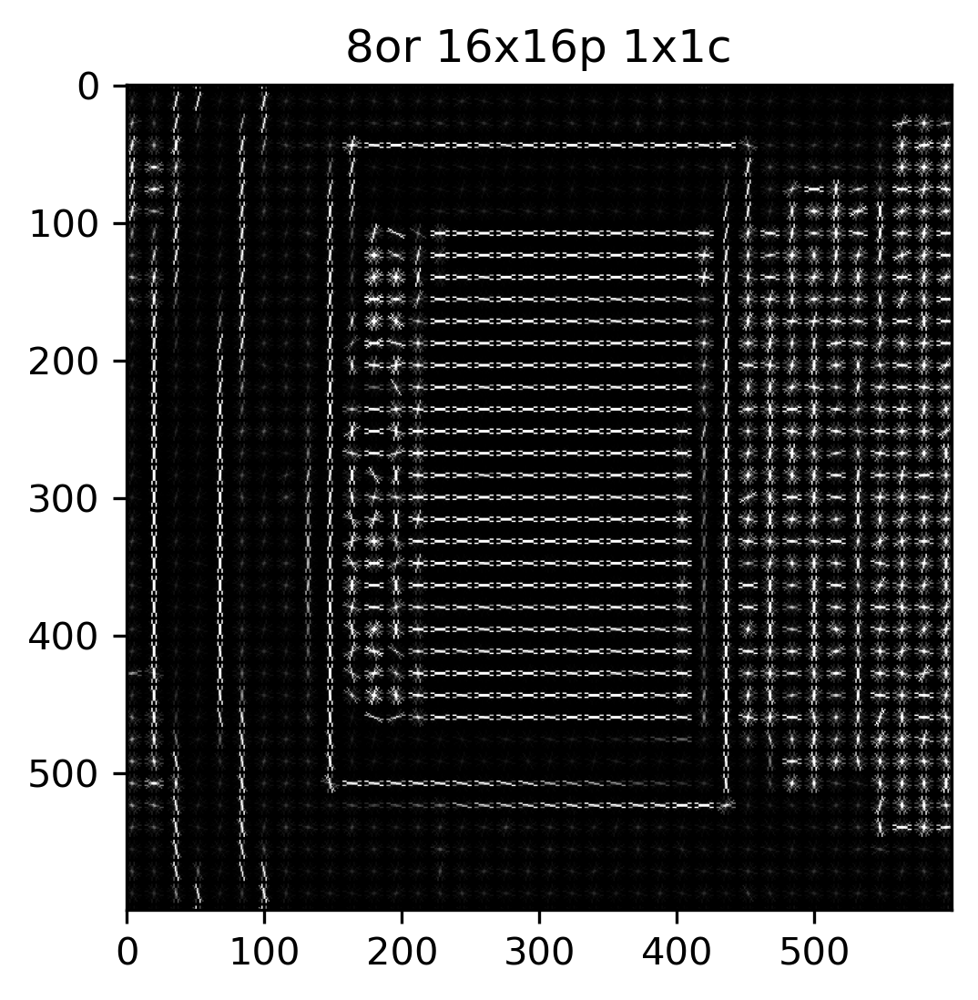

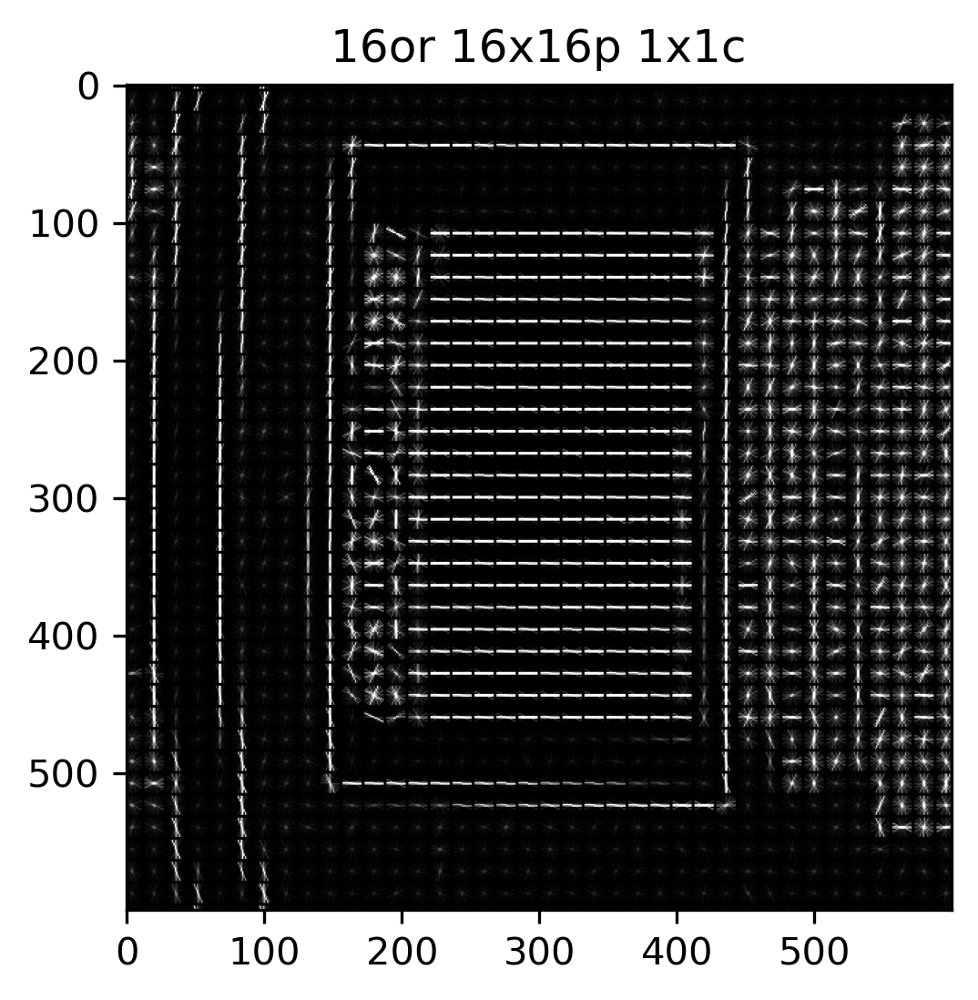

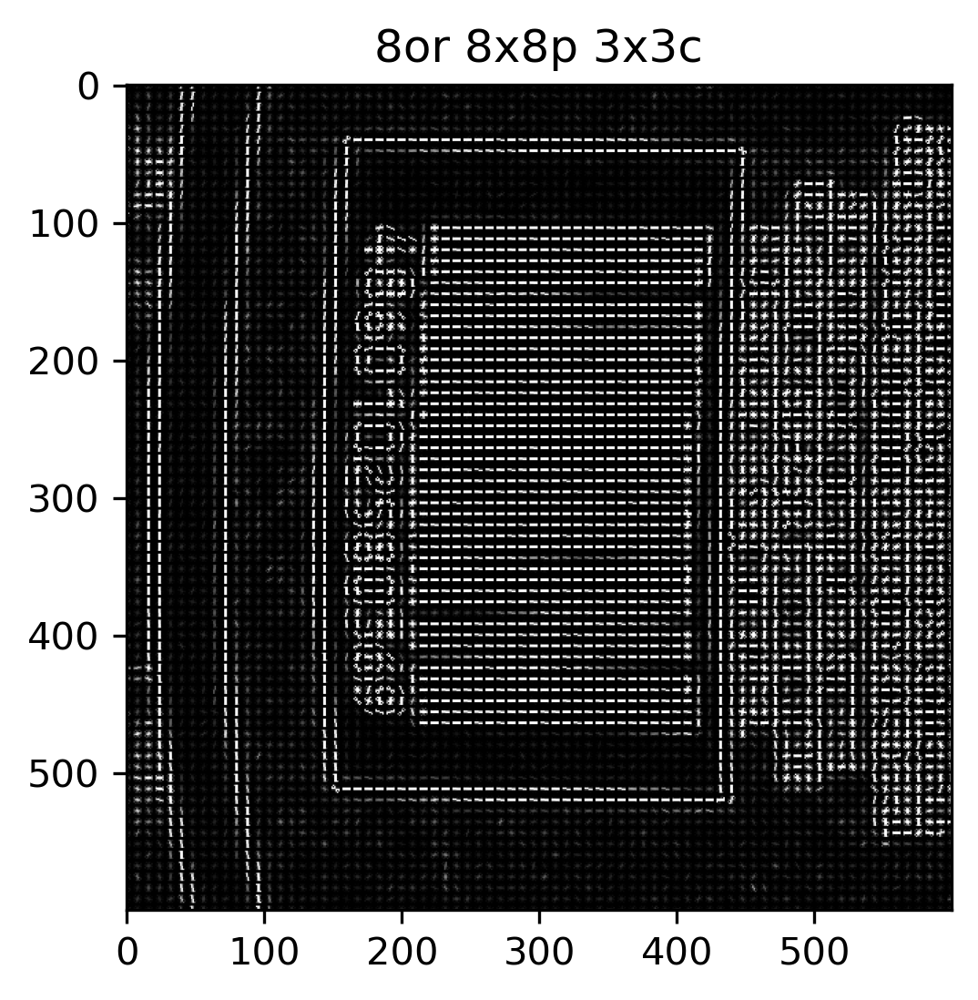

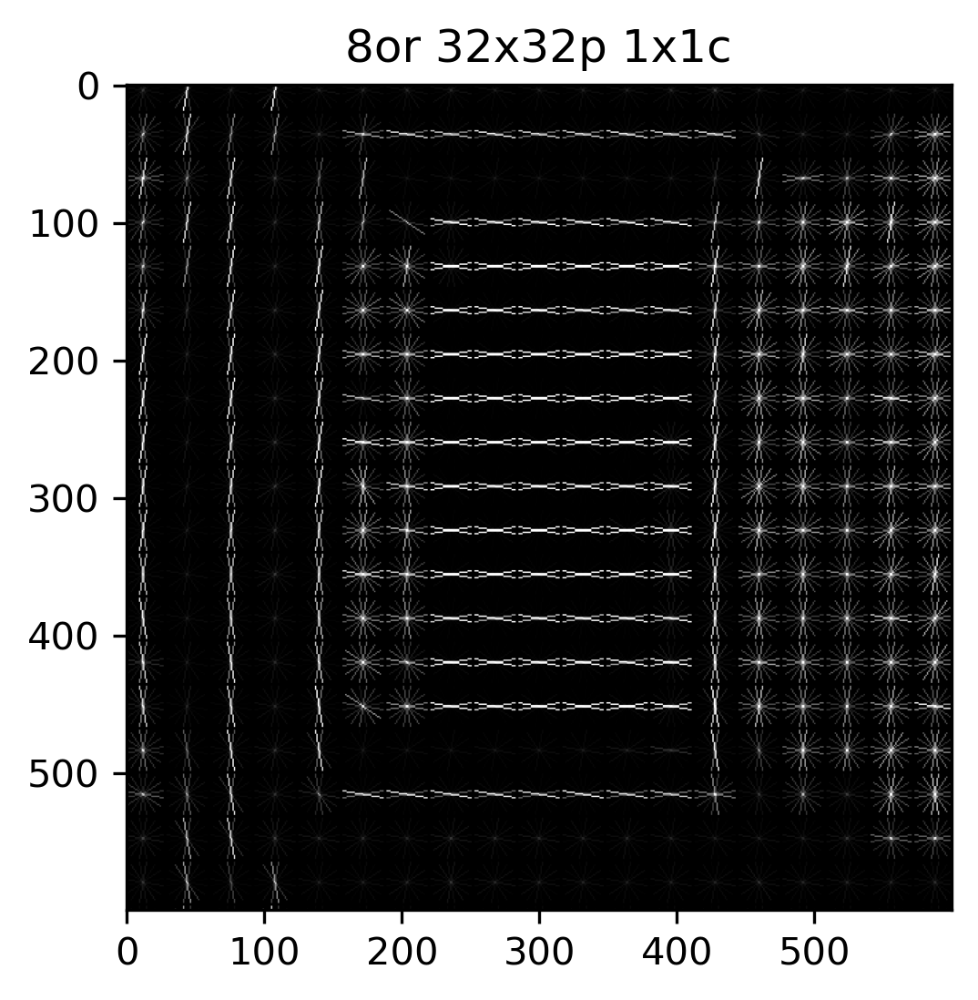

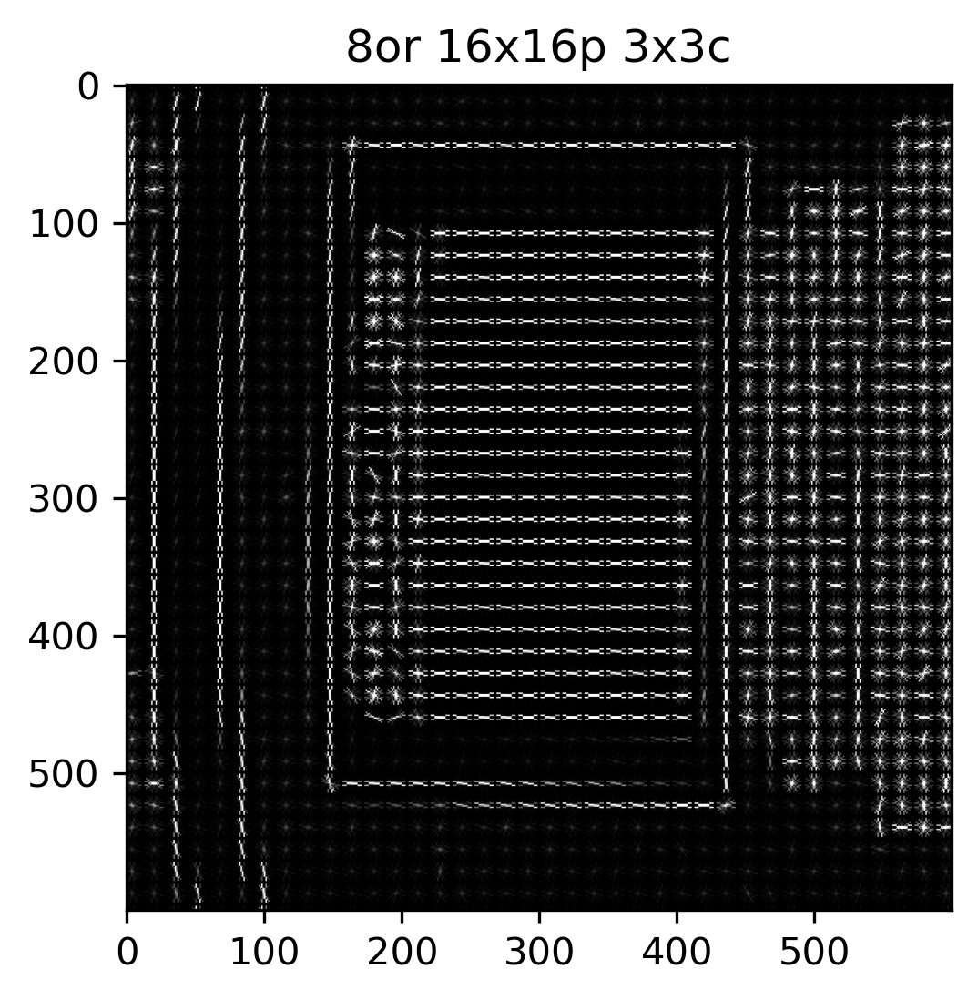

In [13]:
for name,hog_image_rescaled in hogs_rescaled.items():
    imshow(hog_image_rescaled[1500:3000,500:2000][400:1000,400:1000],name =name,cmap =  plt.cm.gray)

In [8]:
fd.shape[0]

614400

## SVM Hog

### Extract barcodes

In [2]:
import os
def get_all_filenames(path):
    if not os.path.exists(path):
        raise Exception("Путь не существует")
    filenames = [os.path.join(root,name)
    for root,dirs,files in os.walk(path)
    for name in files
    if name.endswith(("jpg","jpeg",'png','bmp'))]
    return filenames

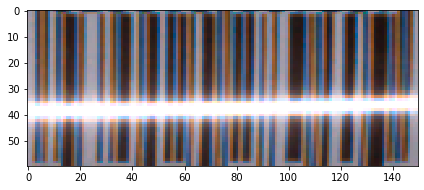

In [3]:
from skimage import io
# barcodes_folder = "C:\\Users\\zgstv\\OneDrive\\Изображения\\barcodes"
barcodes_folder = "C:\\Users\\zgstv\\OneDrive\\Изображения\\barcodes_cropped"

def read_imgs(folder):
    filenames = get_all_filenames(folder)
    return [io.imread(filename) for filename in filenames]

barcodes =  read_imgs(barcodes_folder)
io.imshow(barcodes[0])
# io.show()

In [4]:
len(barcodes)

47

#### Visualize hog of barcodes

In [25]:
barcode_hogs = {}
barcode = barcodes[0]
# barcode = cv.cvtColor(barcode,cv.COLOR_RGB2GRAY);

barcode_hogs['8or 4x4p 3x3c']= hog(barcode,orientations=8,pixels_per_cell=(4,4),cells_per_block=(3,3),visualize=True,multichannel=True)
barcode_hogs['8or 8x8p 3x3c']= hog(barcode,orientations=8,pixels_per_cell=(8,8),cells_per_block=(3,3),visualize=True,multichannel=True)
barcode_hogs['8or 16x16p 3x3c']= hog(barcode,orientations=8,pixels_per_cell=(16,16),cells_per_block=(3,3),visualize=True,multichannel=True)
barcode_hogs['8or 32x32p 3x3c']= hog(barcode,orientations=8,pixels_per_cell=(32,32),cells_per_block=(3,3),visualize=True,multichannel=True)

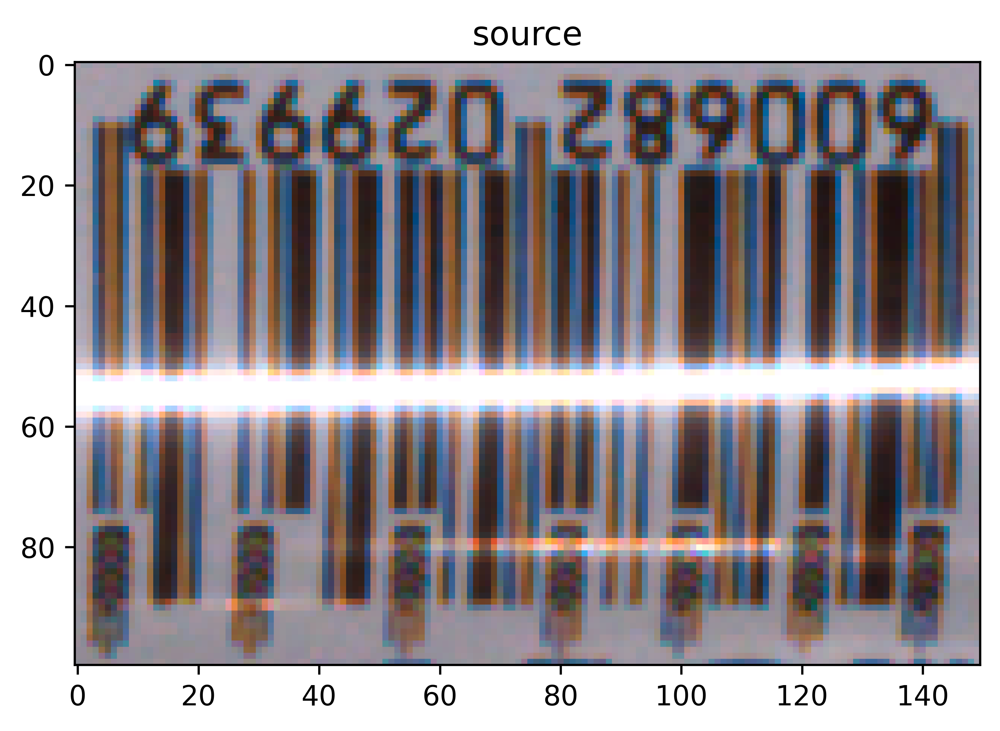

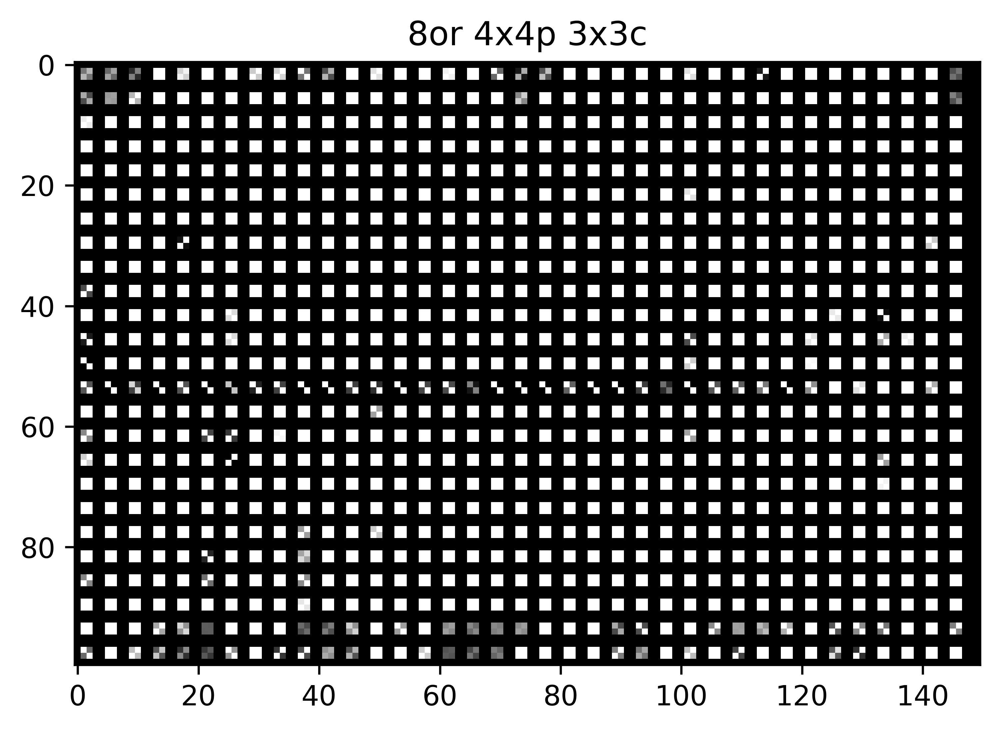

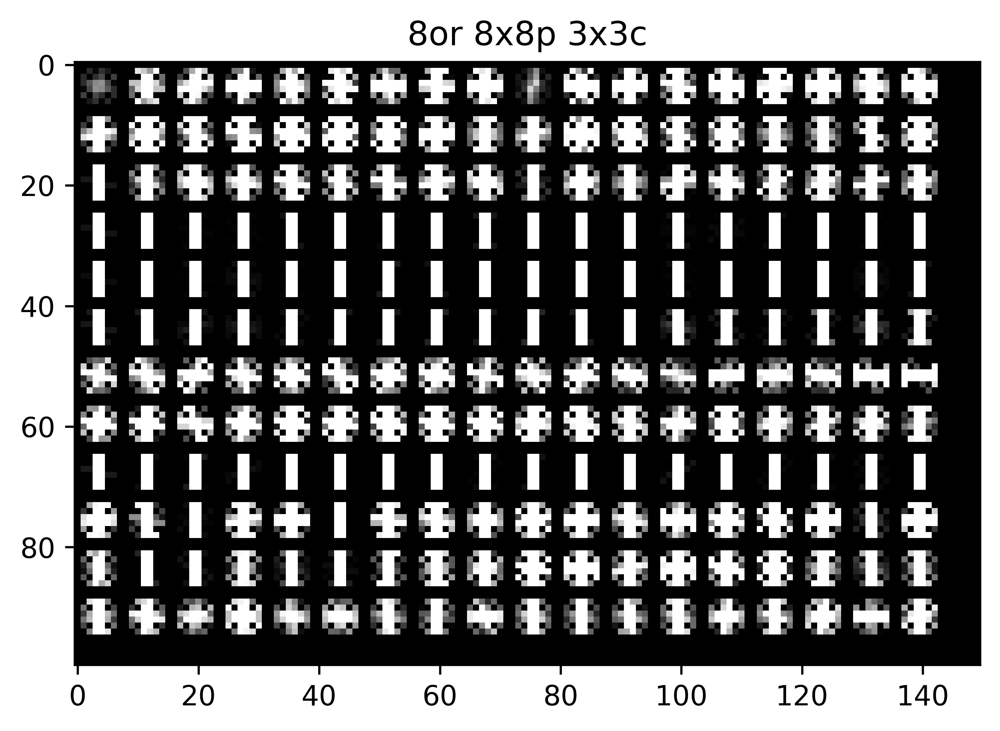

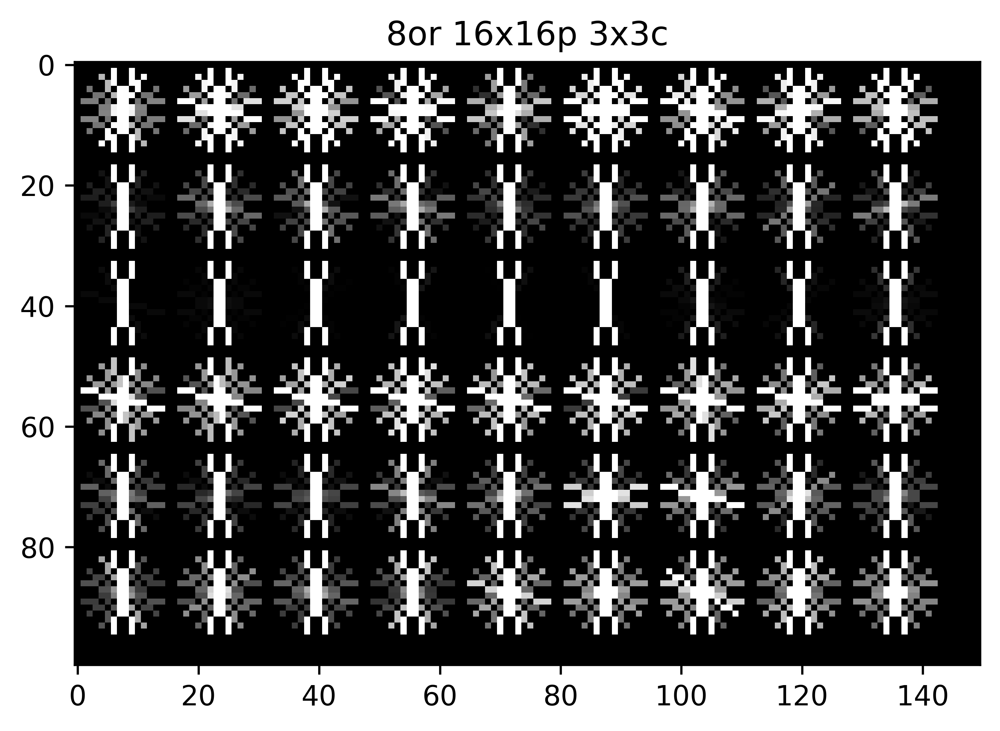

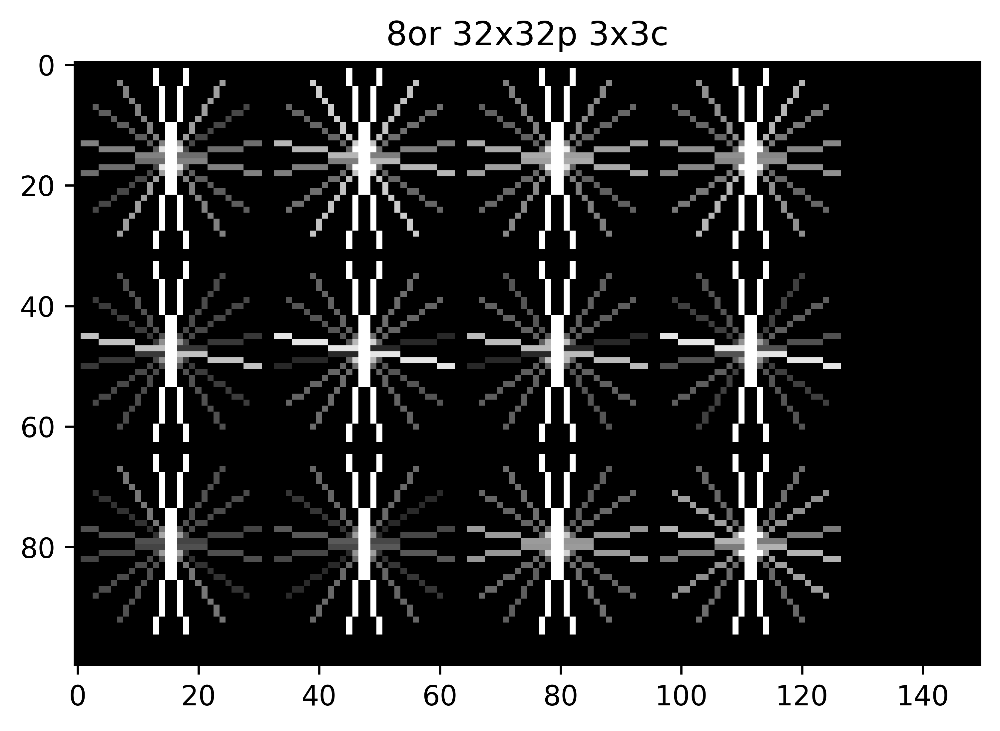

In [26]:
imshow(barcode,name = 'source',cmap = plt.cm.gray)

# Rescale histogram for better display
hogs_rescaled = {key: exposure.rescale_intensity(value[1], in_range=(0, 10)) for key, value in barcode_hogs.items()}

for name,hog_image_rescaled in hogs_rescaled.items():
    imshow(hog_image_rescaled,name= name, cmap=plt.cm.gray)
    imsave(f"barcode_{name}.jpg",hog_image_rescaled,cmap = plt.cm.gray)

#### Resize small barcodes

In [45]:
from skimage import io
barcodes_cropped_folder = "C:\\Users\\zgstv\\OneDrive\\Изображения\\barcodes_fit"

barcodes_cropped =  read_imgs(barcodes_cropped_folder)

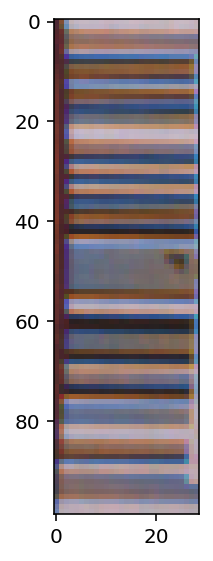

In [48]:
barcode_cropped = barcodes_cropped[4]
io.imshow(barcode_cropped)

In [5]:
from skimage.transform import rescale, resize, downscale_local_mean
def is_horisontal(size):
    return size[0]<size[1]

def approve_orientation(img, size):
    size_h = is_horisontal(size)
    img_h =is_horisontal(img.shape[0:2])
    if size_h != img_h:
        img = img.transpose((1,0,2))
    return img
        
def resize_img(img, size):
    return resize(img,size,anti_aliasing=True)

size = (100,150)

# io.imshow(barcode_resized)

### Extract negative samples

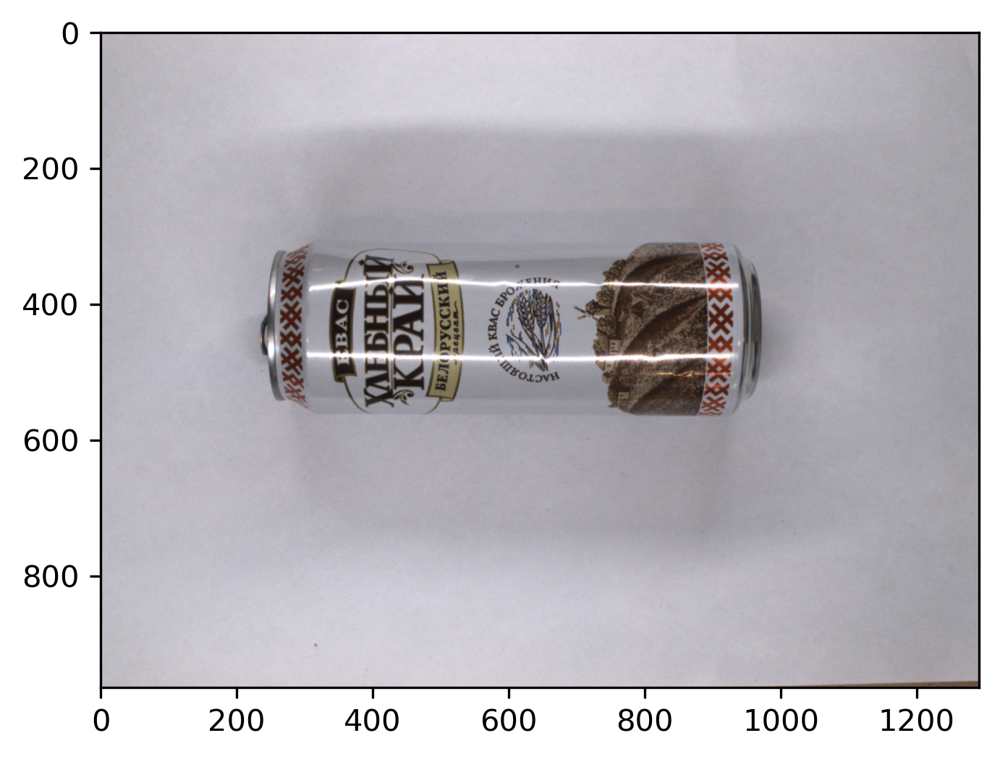

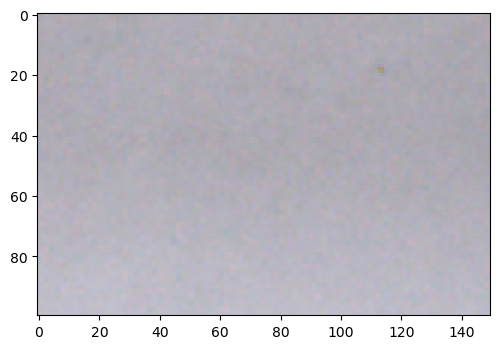

In [6]:
from skimage import data, transform
from sklearn.feature_extraction.image import PatchExtractor
from sklearn.feature_extraction import image
import numpy as np
from numpy.random import default_rng

bottles_folder = "C:\\Users\\zgstv\\OneDrive\\Изображения\\vend_machines"
rng = default_rng()
def extract_patches(img, patch_size,count):
    patches = image.extract_patches_2d(img,patch_size = patch_size,max_patches = count,random_state = 0)
#     extractor = PatchExtractor(patch_size=patch_size,max_patches=count,random_state=0)
#     patches = extractor.transform(img)
    return patches

bottles_filenames = get_all_filenames(bottles_folder)
bottles = [io.imread(filename) for filename in bottles_filenames]
imshow(bottles[0])

count_patches = 50
patch_size = (100,150)
negative_samples = np.vstack([extract_patches(img,patch_size,count_patches) for img in bottles])

imshow(negative_samples[0],dpi=100)



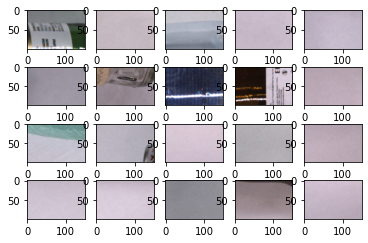

In [8]:
# size = int(negative_samples.shape[0]/10)
size = 20
sample = rng.choice(negative_samples,size =size,replace = False,axis = 0)
_= io.imshow_collection(sample)

In [9]:
print(f"Count of pathces: {bottles[0].shape[0]*bottles[0].shape[1]/150/100}")

Count of pathces: 83.03253333333333


In [10]:
negative_samples.shape
type(barcodes)
type(barcodes[0])

(3550, 100, 150, 3)

list

numpy.ndarray

### Transpose vertical oriented barcodes and drop extra dimensions (if it necessary)

In [11]:
height, width = patch_size
for i in range(len(barcodes)):
    if(barcodes[i].shape[2]>3):
        barcodes[i] = barcodes[i][:,:,0:3]
    barcodes[i] = approve_orientation(barcodes[i],patch_size)
    barcodes[i] = resize(barcodes[i],patch_size)
#     if(barcodes[i].shape[0]==width and barcodes[i].shape[1]==height):
#         barcodes[i] = barcodes[i].transpose(1,0,2)
#     elif(barcodes[i].shape[0]==height and barcodes[i].shape[1]==width):
#         continue
#     else:
#         raise Exception(f"Размер штрихкода {barcodes[i].shape[0],barcodes[i].shape[1]} не совпадает с размером негативных патчей {patch_size}")

    if patch_size != barcodes[i].shape[0:2]:
        raise Exception(f"Размер штрихкода {barcodes[i].shape[0],barcodes[i].shape[1]} не совпадает с размером негативных патчей {patch_size}")
            
barcodes = np.array(barcodes) 


In [12]:
barcodes.shape

(47, 100, 150, 3)

### Extract HOG features

In [14]:
from skimage import feature   
from itertools import chain
from tqdm import tqdm

positive_patches = barcodes
negative_patches = negative_samples

InteractiveShell.ast_node_interactivity = "last_expr"

X_train = np.array([feature.hog(im)
                    for im in tqdm(chain(positive_patches,
                                    negative_patches))])
InteractiveShell.ast_node_interactivity = "all"

y_train = np.zeros(X_train.shape[0])
y_train[:positive_patches.shape[0]] = 1

3597it [00:43, 82.86it/s] 


In [15]:
X_train.shape
y_train.shape

(3597, 12960)

(3597,)

### Training a SVM classifier

In [16]:
from sklearn.svm import LinearSVC
from sklearn.model_selection import GridSearchCV 

grid = GridSearchCV(LinearSVC(dual=False), {'C': [1.0, 2.0, 4.0, 8.0]},cv=3)
grid.fit(X_train, y_train)
grid.best_score_

GridSearchCV(cv=3, estimator=LinearSVC(dual=False),
             param_grid={'C': [1.0, 2.0, 4.0, 8.0]})

1.0

In [17]:
model = grid.best_estimator_

**or**

In [15]:
#model = LinearSVC(C=4.0, dual=False)

In [18]:
model.fit(X_train, y_train)

LinearSVC(dual=False)

### Detect barcode on a bottle image

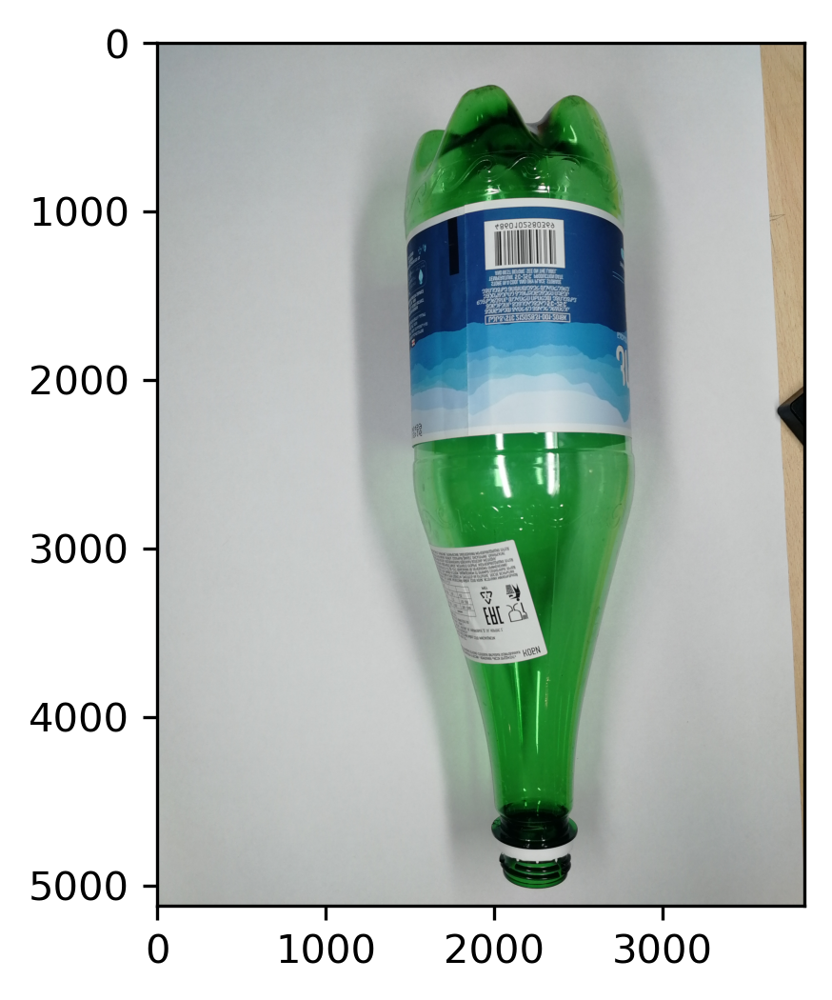

In [19]:
# Apply sliding window function to test_image
# test = test_image_roi
# test = test_img_resized
test = green_hq.transpose((1,0,2))
imshow(test)

In [20]:
# Sliding Window function - Goes Over the image patch by patch
# and computes the HOG features for each patch.


# def sliding_window(img, patch_size,
#                    istep=2, jstep=2, scale=1.0):
#     Ni, Nj = (int(scale * s) for s in patch_size)
#     for i in range(0, img.shape[0] - Ni, istep):
#         for j in range(0, img.shape[1] - Ni, jstep):
#             patch = img[i:i + Ni, j:j + Nj]
#             if scale != 1:
#                 patch = transform.resize(patch, patch_size)
#             yield (i, j), patch

def sliding_window(img,patch_size,i_step=2,j_step=2):
    patch_height, patch_width = patch_size
    img_height = img.shape[0]
    img_width = img.shape[1]
    
    for i in range(0,img_height-patch_height,i_step):
        for j in range(0,img_width-patch_width,j_step):
            patch = img[i:i+patch_height,j:j+patch_width]
#             type(patch)
            if (patch.shape[0],patch.shape[1]) != patch_size:
                raise Exception(f"Размер текущего патча {(patch.shape[0],patch,shape[1])} не равен заданному размеру патчей {patch_size} ")
            yield (i,j),patch

In [21]:
indices, patches = zip(*sliding_window(test,patch_size=patch_size,i_step = 30,j_step=30))

In [22]:
type(patches)
type(indices)
len(patches)
len(indices)
patches[0].shape

tuple

tuple

20664

20664

(100, 150, 3)

In [23]:
InteractiveShell.ast_node_interactivity = "last_expr"

from tqdm import tqdm

patches_hog = np.array([feature.hog(patch) for patch in tqdm(patches)])

InteractiveShell.ast_node_interactivity = "all"

100%|██████████| 20664/20664 [04:46<00:00, 72.16it/s]


In [24]:
type(patches_hog)
patches_hog.shape
type(patches_hog[0])
patches_hog[0].shape
patches_hog[1].shape

numpy.ndarray

(20664, 12960)

numpy.ndarray

(12960,)

(12960,)

#### Stack arrays of different shapes (**not need**)

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last_expr"

patches_hog_stacked = patches_hog
length = X_train.shape[1]
print(length)


for i in tqdm(range(1,patches_hog_stacked.shape[0])):
    current_length = patches_hog_stacked[i].shape[0]
    if length>current_length:
#         print(current_length)
        patches_hog_stacked[i]=np.pad(patches_hog_stacked[i],(0,length - current_length),mode = "mean")
    elif length<current_length:
#         print(current_length)
        patches_hog_stacked[i]=patches_hog_stacked[i][:length]
            
        
# patches_hog_stacked = np.vstack(patches_hog_stacked)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [67]:
patches_hog_stacked.shape
patches_hog_stacked = np.vstack(patches_hog_stacked)
patches_hog_stacked.shape

(15000,)

In [72]:
patches_hog_stacked.shape
patches_hog_stacked[0,10]

(15000, 12960)

0.12408929785764167

#### Predict

In [25]:
# Use the model to evaluate if HOG patches of the image
# contains a face
labels = model.predict(patches_hog)
labels.sum() # number of barcode detections from all the patches in the image

78.0

### Visualize the detections

In [26]:
InteractiveShell.ast_node_interactivity = "last_expr"

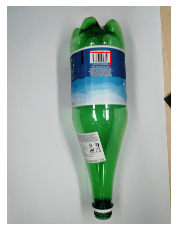

In [38]:
fig, ax = plt.pyplot.subplots()
# ax.imshow(test_image_roi)
ax.imshow(test)
# ax.imshow(test_img_resized)

ax.axis('off')

Ni, Nj = patch_size
indices = np.array(indices)

# for i, j in indices[labels == 1][0::10]:
#     ax.add_patch(plt.pyplot.Rectangle((j, i), Nj, Ni, edgecolor='red',
#                                alpha=0.3, lw=2, facecolor='none'))
top_left = indices[labels == 1].max(axis = 0)[::-1]
bottom_right = indices[labels == 1].min(axis = 0)[::-1]
Ni = top_left[1] - bottom_right[1]+ patch_size[1]
Nj = top_left[0] - bottom_right[0] + patch_size[0]

ax.add_patch(plt.pyplot.Rectangle(bottom_right, Nj, Ni, edgecolor='red',
                             alpha=0.9, lw=1, facecolor='none'))
# ax.add_patch(plt.pyplot.Rectangle(indices[labels == 1].max(axis = 0)[::-1], Nj, Ni, edgecolor='blue',
#                                alpha=0.9, lw=2, facecolor='none'))
# ax.add_patch(plt.pyplot.Rectangle(indices[labels == 1].min(axis = 0)[::-1], Nj, Ni, edgecolor='green',
#                                alpha=0.9, lw=2, facecolor='none'))


In [39]:
fig.savefig("result4.png",dpi=1000)

In [ ]:
InteractiveShell.ast_node_interactivity = "all"

### Test on another bottle

In [15]:
green_hq = green_hq
first_img= test_image
first_img_roi = test_image_roi
imshow(green_hq)
imshow(first_img)
imshow(first_img_roi)

NameError: name 'test_image' is not defined

In [97]:
green_hq.shape
first_img.shape
first_img_roi.shape
green_hq.shape[1]/green_hq.shape[0]
first_img.shape[1]/first_img.shape[0]

(3840, 5120, 3)

(964, 1292, 3)

(300, 400, 3)

1.3333333333333333

1.3402489626556016

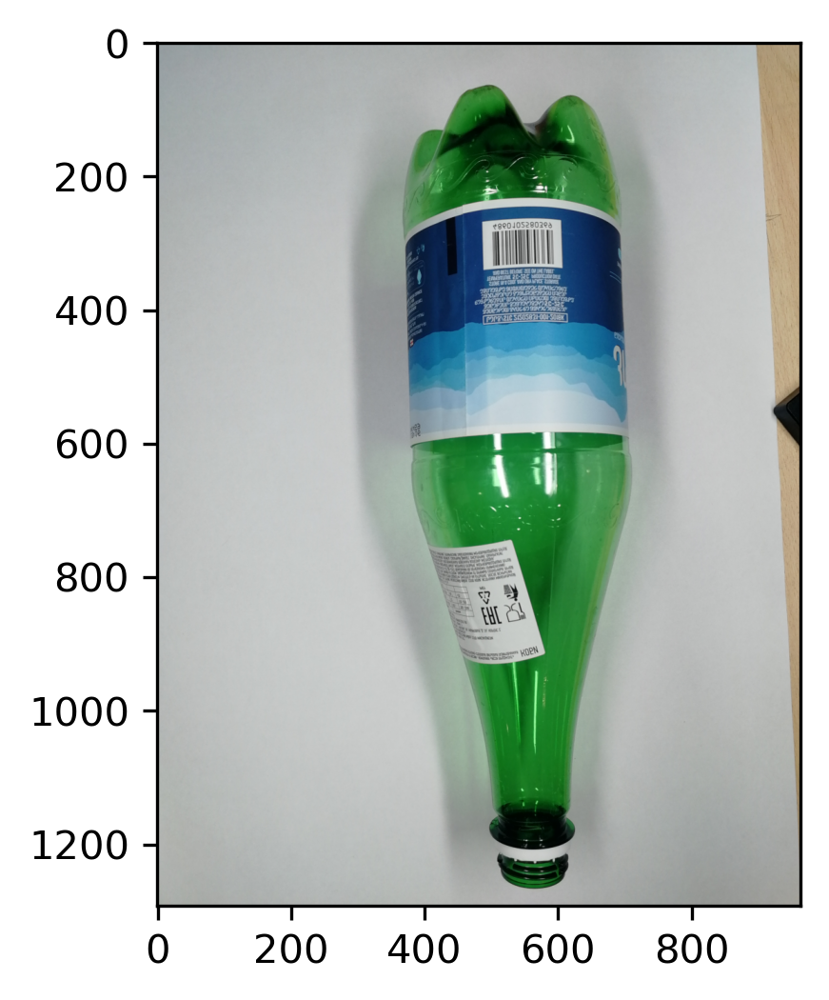

In [35]:
from skimage.transform import rescale, resize, downscale_local_mean

test_img_resized = resize(green_hq,(first_img.shape[0],first_img.shape[1]),anti_aliasing=True)
test_img_resized.shape
test_img_resized = test_img_resized.transpose((1,0,2))
imshow(test_img_resized)

## Selective search

### Lib example

In [1]:
import skimage.data
import selectivesearch

img = skimage.data.astronaut()
img_lbl, regions = selectivesearch.selective_search(img, scale=500, sigma=0.9, min_size=10)
regions[:10]

[{'rect': (0, 0, 15, 26), 'size': 313, 'labels': [0.0]},
 {'rect': (0, 0, 61, 144), 'size': 4794, 'labels': [1.0]},
 {'rect': (10, 0, 103, 227), 'size': 2071, 'labels': [2.0]},
 {'rect': (46, 0, 353, 326), 'size': 43655, 'labels': [3.0]},
 {'rect': (396, 0, 12, 74), 'size': 193, 'labels': [4.0]},
 {'rect': (393, 0, 42, 184), 'size': 4752, 'labels': [5.0]},
 {'rect': (423, 0, 22, 62), 'size': 322, 'labels': [6.0]},
 {'rect': (430, 0, 81, 269), 'size': 15441, 'labels': [7.0]},
 {'rect': (22, 11, 18, 20), 'size': 68, 'labels': [8.0]},
 {'rect': (183, 14, 122, 219), 'size': 1147, 'labels': [9.0]}]

In [3]:
from __future__ import (
    division,
    print_function,
)

import skimage.data
import matplotlib as plt
import matplotlib.patches as mpatches
import selectivesearch


def search(img,min_size=10,display_all_regions = True):

    # loading astronaut image
    # perform selective search
    img_lbl, regions = selectivesearch.selective_search(
        img, scale=500, sigma=0.9, min_size=min_size)

    candidates = set()
    excluded_by_size = set()
    excluded_by_resolution = set()
    for r in regions:
        # excluding same rectangle (with different segments)
        if r['rect'] in candidates:
            continue
        # excluding regions smaller than 2000 pixels
        size = r['size']
        if size < 7000 or size > 20000:
            excluded_by_size.add(r['rect'])
            continue
        # distorted rects
        x, y, w, h = r['rect']
        img_resolution = max(w/h,h/w)
        if img_resolution <1.3 or img_resolution >2:
            excluded_by_resolution.add(r['rect'])
            continue
        candidates.add(r['rect'])

    # draw rectangles on the original image
    fig, ax = plt.pyplot.subplots(ncols=1, nrows=1, figsize=(6, 6),dpi =300)
    ax.imshow(img)
    print(len(candidates))
    for x, y, w, h in candidates:
        print(x, y, w, h)
        rect = mpatches.Rectangle(
            (x, y), w, h, fill=False, edgecolor='red', linewidth=1)
        ax.add_patch(rect)
    if display_all_regions:
        for x, y, w, h in excluded_by_size:
    #         print(x, y, w, h)
            rect = mpatches.Rectangle(
                (x, y), w, h, fill=False, edgecolor='blue', linewidth=1)
            ax.add_patch(rect)

        for x, y, w, h in excluded_by_resolution:
    #         print(x, y, w, h)
            rect = mpatches.Rectangle(
                (x, y), w, h, fill=False, edgecolor='green', linewidth=1)
            ax.add_patch(rect)

    plt.pyplot.show()



12
265 336 241 175
0 333 260 178
288 363 200 148
265 336 246 175
246 236 110 212
0 333 237 178
152 14 153 219
368 240 143 242
148 337 125 174
133 155 160 106
109 14 196 270
254 236 102 144


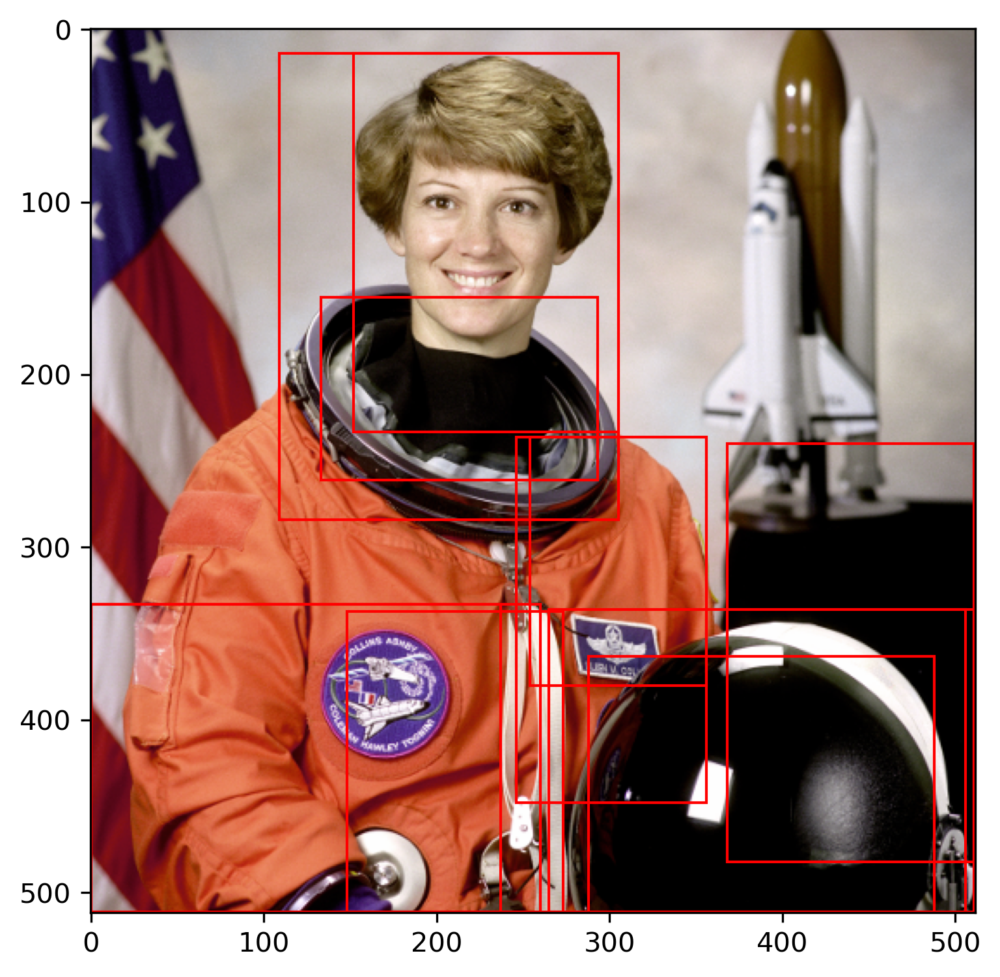

In [21]:
img = skimage.data.astronaut()
search(img,display_all_regions=False)

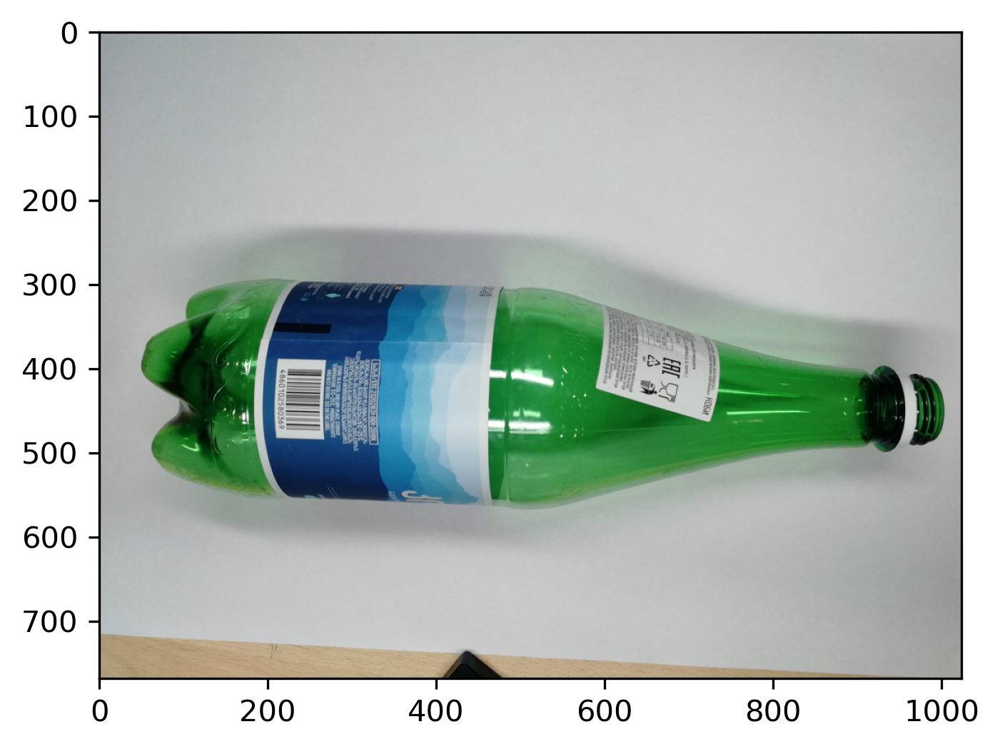

In [5]:
from skimage.transform import rescale, resize, downscale_local_mean
img = green_hq
green_rescaled = rescale(img,0.2,anti_aliasing=True,channel_axis = 2)
imshow(green_rescaled)


3
200 297 134 201
196 389 254 171
829 394 177 105


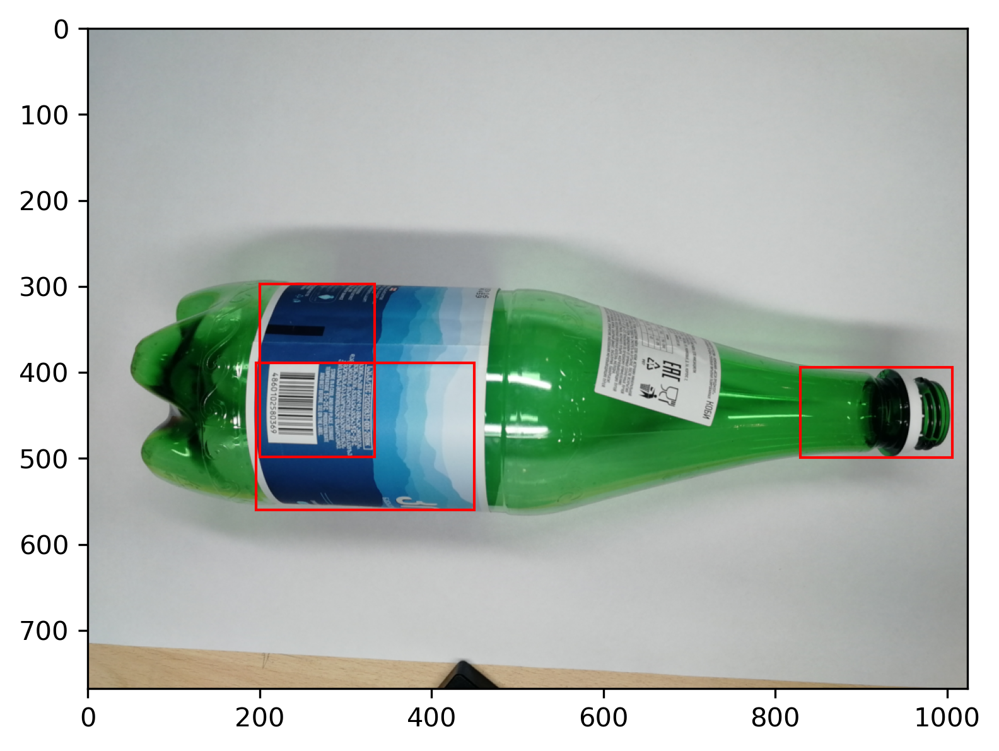

In [6]:
search(green_rescaled,min_size = 10, display_all_regions = False)

5
237 321 444 264
735 439 209 143
748 439 196 141
237 324 403 261
735 439 209 141


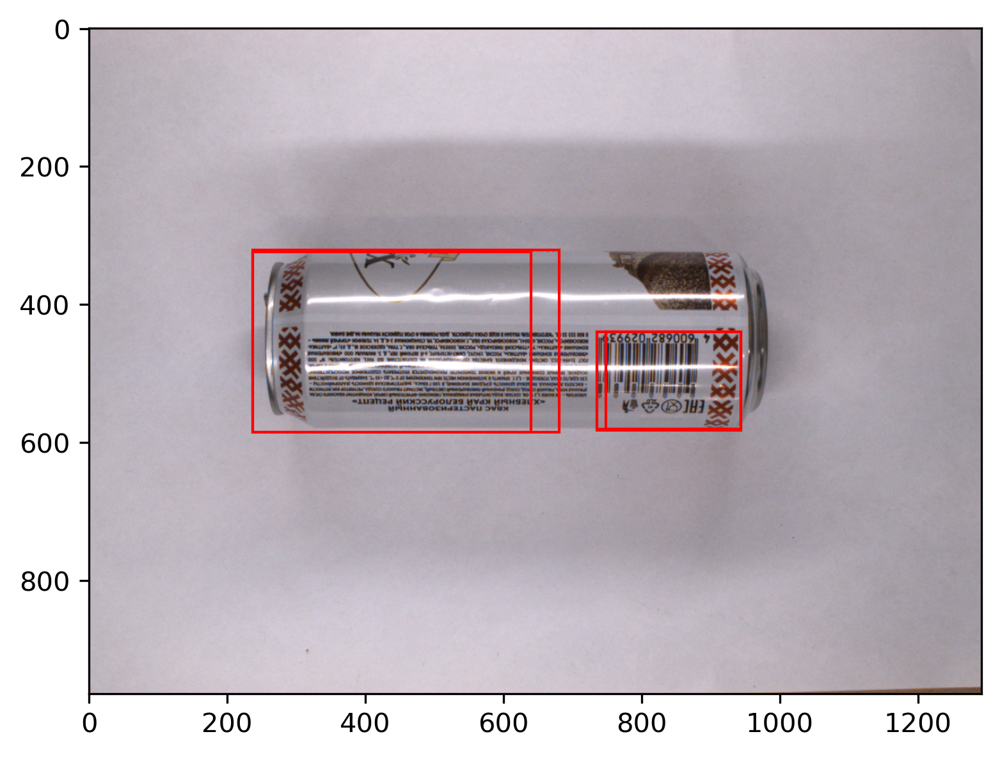

In [4]:
search(white_lq,min_size = 10, display_all_regions = False)

### Opencv example

In [31]:
#!/usr/bin/env python


import sys
import cv2

# @benchmark
def ocv_search(im,s_type ='q',**search_kwargs):
    '''
    Usage:
        ./ssearch.py input_image (f|q|s)
        f=fast, q=quality, s=single strategy
    Use "l" to display less rects, 'm' to display more rects, "q" to quit.
    '''


    # speed-up using multithreads
    cv2.setUseOptimized(True);
    cv2.setNumThreads(4);

    # read image
#     im = cv2.imread(sys.argv[1])
    # resize image
    newHeight = 500
    newWidth = int(im.shape[1]*newHeight/im.shape[0])
    im = cv2.resize(im, (newWidth, newHeight))    

    # create Selective Search Segmentation Object using default parameters
    ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

    s_types= {'q':ss.switchToSelectiveSearchQuality,'f':ss.switchToSelectiveSearchFast,'s':ss.switchToSingleStrategy}
    if not search_kwargs:
        search_kwargs ={ "sigma":0.9}
        if s_type=='q' or s_type == 'f':
            search_kwargs['base_k'] = 150
            search_kwargs['inc_k'] = 150
        elif s_type == 's':
            search_kwargs['k'] = 500
    # set input image on which we will run segmentation
    ss.setBaseImage(im)
    # Switch to fast but low recall Selective Search method
    # Switch to high recall but slow Selective Search method
    try:
        s_types[s_type](**search_kwargs)
    except KeyError: 
        raise Exception("Некорректный тип выборочного поиска")
        sys.exit(1)

    # run selective search segmentation on input image
    rects = benchmark(ss.process)()
    print('Total Number of Region Proposals: {}'.format(len(rects)))
    
    # number of region proposals to show
    numShowRects = 10
    # increment to increase/decrease total number
    # of reason proposals to be shown
    increment = 5
    divide = 2

    while True:
        # create a copy of original image
        imOut = im.copy()

        # itereate over all the region proposals
        for i, rect in enumerate(rects):
            # draw rectangle for region proposal till numShowRects
            if (i < numShowRects):
                x, y, w, h = rect
                if w*h >1000 and w*h <50000:
                    cv2.rectangle(imOut, (x, y), (x+w, y+h), (0, 255, 0), 1, cv2.LINE_AA)
            else:
                break

        # show output
        cv2.namedWindow("Result",cv2.WINDOW_NORMAL)
        cv2.resizeWindow("Result",newWidth, newHeight)
        cv2.imshow("Result", imOut);

        # record key press
        k = cv2.waitKey(0) & 0xFF

        # m is pressed
        if k == 109:
            # increase total number of rectangles to show by increment
            numShowRects += increment
#             if increment <50:
#                 increment *=2
        # l is pressed
        elif k == 108 and numShowRects > increment:
            # decrease total number of rectangles to show by increment
            numShowRects -= increment
#             if numShowRects <=increment:
#                 increment = int(increment/2)
        # q is pressed
        elif k == 113:
            break
    # close image show window
    cv2.destroyAllWindows()

In [33]:
ocv_search(green_hq,s_type = 'q')

[*] Время выполнения: 15.50460934638977 секунд.
Total Number of Region Proposals: 3646


In [32]:
ocv_search(white_lq,s_type = 's')

[*] Время выполнения: 0.5259065628051758 секунд.
Total Number of Region Proposals: 93


## Felzenszwalb Segmentation

### Skimage example

Felzenszwalb number of segments: 194
SLIC number of segments: 196
Quickshift number of segments: 695


Text(0.5, 1.0, "Felzenszwalbs's method")

Text(0.5, 1.0, 'SLIC')

Text(0.5, 1.0, 'Quickshift')

Text(0.5, 1.0, 'Compact watershed')

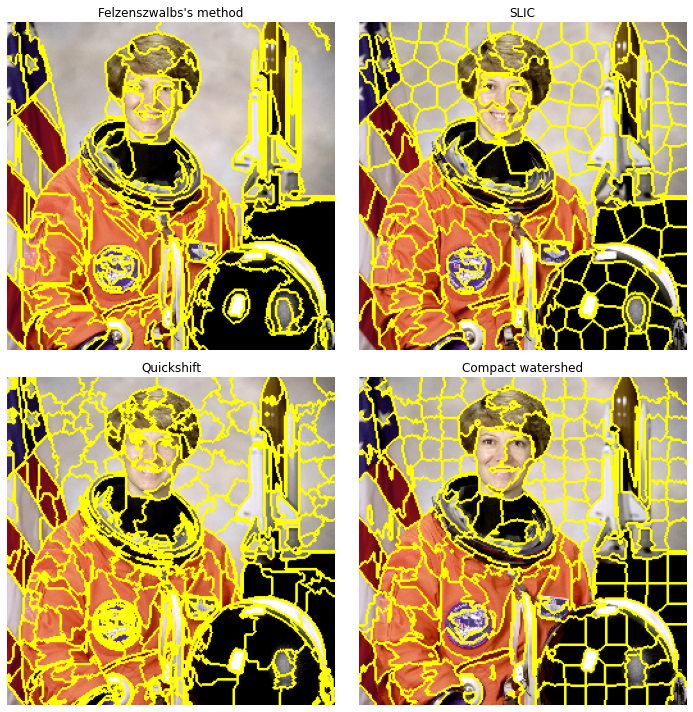

In [4]:
import matplotlib as plt
import numpy as np

from skimage.data import astronaut
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float

img = img_as_float(astronaut()[::2, ::2])

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1,
                     start_label=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)
gradient = sobel(rgb2gray(img))
segments_watershed = watershed(gradient, markers=250, compactness=0.001)

print(f'Felzenszwalb number of segments: {len(np.unique(segments_fz))}')
print(f'SLIC number of segments: {len(np.unique(segments_slic))}')
print(f'Quickshift number of segments: {len(np.unique(segments_quick))}')

fig, ax = plt.pyplot.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_fz))
ax[0, 0].set_title("Felzenszwalbs's method")
ax[0, 1].imshow(mark_boundaries(img, segments_slic))
ax[0, 1].set_title('SLIC')
ax[1, 0].imshow(mark_boundaries(img, segments_quick))
ax[1, 0].set_title('Quickshift')
ax[1, 1].imshow(mark_boundaries(img, segments_watershed))
ax[1, 1].set_title('Compact watershed')

for a in ax.ravel():
    a.set_axis_off()

plt.pyplot.tight_layout()
plt.pyplot.show()

### Bottle image

Felzenszwalb number of segments: 21


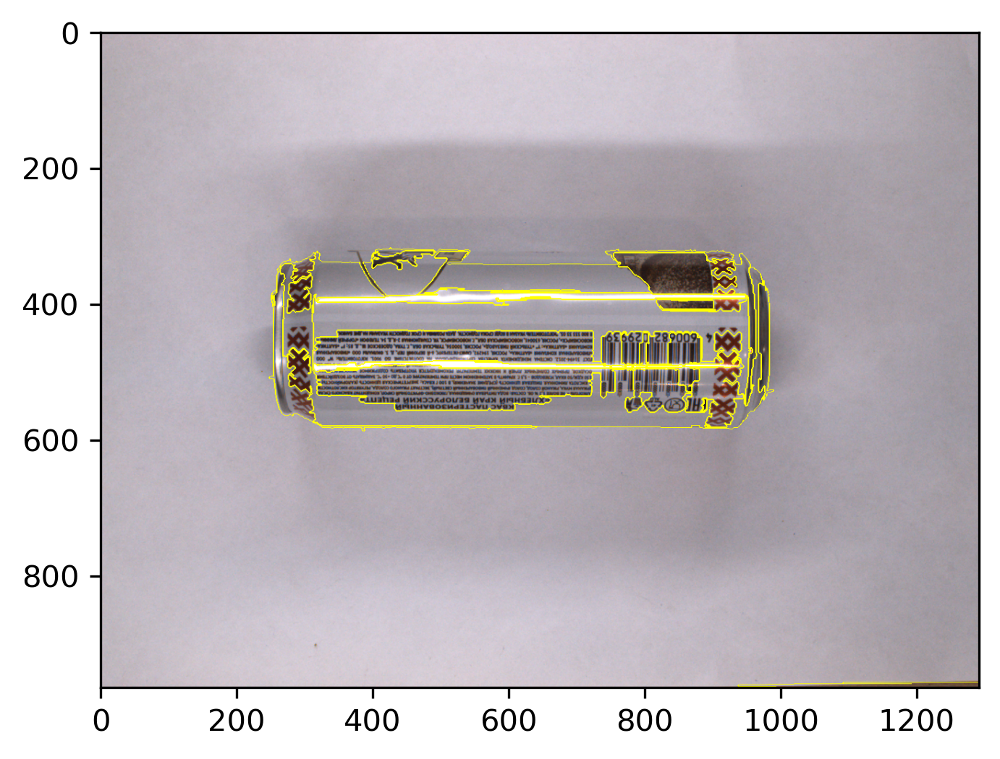

In [14]:
img = white_lq
segments_fz = felzenszwalb(img, scale=500, sigma=0.9, min_size=1000)
print(f'Felzenszwalb number of segments: {len(np.unique(segments_fz))}')
imshow(mark_boundaries(img, segments_fz))